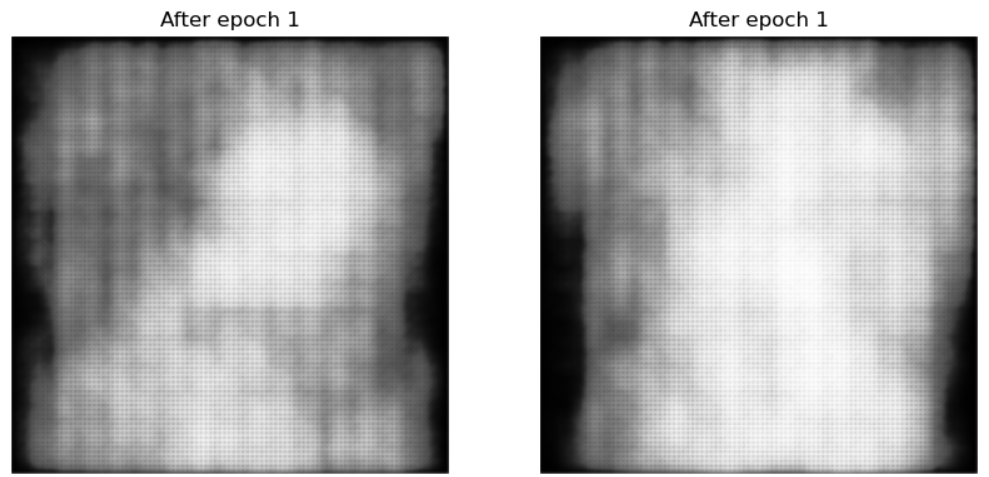
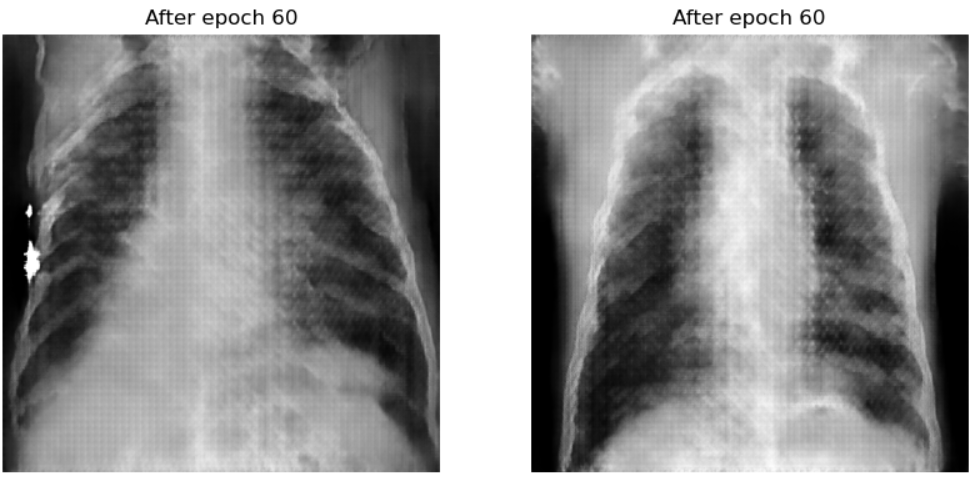

This notebook uses Generative Adversarial Networks (GANs) to generate synthetic pneumonia-positive X-ray images. The goal is to generate hyperrealistic images that can be used to augment the existing dataset for better model training. The current demo has yet to achieve this goal, but the plan is to explore the application of Generative Adversarial Networks (GANs) to generate new and accurate medical images in the future.

**The primary aim is to train the GAN to generate highly realistic synthetic X-ray images that closely resemble the real ones in the dataset. These synthetic images can then be utilized for future data augmentation.**

As of the current demonstration, the generated images might not yet reach clinically accurate levels. However, **a more complex architecture has the potential to generate highly realistic and accurate pneumonia-positive X-ray images.** The synthetic images produced can effectively augment existing datasets of pneumonia-positive X-rays, leading to improved accuracy and performance of pneumonia detection models

The main takeaway from this project is the potential of GANs in medical image generation for data augmentation, enabling the development of more effective diagnostic tools for pneumonia and other medical conditions.


# Configuration Details:

* GPU Accelerator: T4 (2 units)
* Dataset: **[Chest X-ray Pneumonia](https://www.kaggle.com/datasets/paultimothymooney/chest-xray-pneumonia)** 
* Dataset Size: 3875
* Output Image Size: 512x512
* Optimizer: Adam
* Learning Rate: 0.0002
* Loss Function: Binary Crossentropy
* Generator: 1 Dense, 6 Convolutional Transpose, 1 Convolutional
* Discriminator: 4 Convolutional, 4 MaxPooling, 1 Flatten, 2 Dense

# Import

In [ ]:
import os
import time
import cv2 as cv
import numpy as np
import pandas as pd
import tensorflow as tf
import matplotlib.pyplot as plt
from keras.utils import np_utils
from keras.models import Sequential, Model
from sklearn.model_selection import train_test_split
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from keras.layers import Input, Dense, BatchNormalization, Conv2D, Conv2DTranspose, ReLU, LeakyReLU, Flatten, MaxPooling2D, Dropout, Reshape

# GPU Initialization

In [7]:
strategy = tf.distribute.MirroredStrategy()
print('DEVICES AVAILABLE: {}'.format(strategy.num_replicas_in_sync))

DEVICES AVAILABLE: 2


# Initialization

In [8]:
#initially I went for 128*128, later decided to go with 512*512 image size
BUFFER_SIZE = 64000
BATCH_SIZE = 32*strategy.num_replicas_in_sync
batch_size = BATCH_SIZE
EPOCHS = 1000
latent_dim = 128
input_size = [256*2, 256*2, 3]
image_size = (256*2, 256*2)

# Data Preprocessing

In [9]:
#Creating dataset with ImageDataGenerator is way simpler than other methods
datagen = ImageDataGenerator(
    rescale=1./255,   
# Initially created the datatest with some augmentation, then realised, bad idea.
#     shear_range=0.2,      
#     zoom_range=0.2,       
#     horizontal_flip=True 
)

image_directory = '/kaggle/input/chest-xray-pneumonia/chest_xray'

dataset= datagen.flow_from_directory(
    os.path.join(image_directory, 'train'),   
    classes=['PNEUMONIA'],   
    target_size=image_size,        
    batch_size=BATCH_SIZE,      
    class_mode='binary',        
    shuffle=True                 
)


Found 3875 images belonging to 1 classes.


In [10]:
len(dataset)

122

# Generator Model

In [15]:
def gen_model():
    #in case you get OOM error, change the filter size, set it to a smaller value, 28 for example
    model = Sequential([
        Input(shape = (latent_dim,)),
        Dense(8*8*256),
        Reshape((8, 8, 256)),
        Conv2DTranspose(128*2, kernel_size = 4, strides = 2, padding = 'same'), 
        LeakyReLU(alpha=0.1),
        Conv2DTranspose(128*3, kernel_size=4, strides=2, padding='same'),
        LeakyReLU(alpha=0.1),
        Conv2DTranspose(128*3, kernel_size=4, strides=2, padding='same'),
        LeakyReLU(alpha=0.1),
        Conv2DTranspose(128*4, kernel_size=4, strides=2, padding='same'),
        LeakyReLU(alpha=0.1),
        Conv2DTranspose(128*5, kernel_size=4, strides=2, padding='same'),
        LeakyReLU(alpha=0.1),
        Conv2DTranspose(128*6, kernel_size=4, strides=2, padding='same'),
        LeakyReLU(alpha=0.1),
        Conv2D(3, kernel_size =4, padding = 'same', activation = 'sigmoid')
    ],
        name = "generator"
    )
    return model



# Discriminator Model

In [ ]:
def disc_model():
    #in case you get OOM error, change the filter size, set it to a smaller value, 256 or lower for example
    #keep reducing that value untill the error goes away.
    model = Sequential([
        Input(shape = input_size),
        Conv2D(256, kernel_size = 4, strides= 2, padding = 'same'),
        BatchNormalization(),
        LeakyReLU(alpha=0.1),
        MaxPooling2D(strides = 2),
        Conv2D(256*2, kernel_size=4, strides=2, padding='same'),
        BatchNormalization(),
        LeakyReLU(alpha=0.1),
        MaxPooling2D(strides=2),
        Conv2D(256*3, kernel_size=4, strides=2, padding='same'),
        BatchNormalization(),
        LeakyReLU(alpha=0.1),
        MaxPooling2D(strides=2),
        Conv2D(256*4, kernel_size=4, strides=2, padding='same'),
        BatchNormalization(),
        LeakyReLU(alpha=0.1),
        MaxPooling2D(strides=2),
        
        Flatten(),
        Dense(256*4),
        LeakyReLU(alpha=0.1),
        Dropout(0.2),
        Dense(1, activation = 'sigmoid')
    ], 
        name = "discriminator"
    )
    return model



In [16]:
with strategy.scope(): 
    #In order to utilize mutliple GPU, 
    #you  must declare model, optimizers and checkpoints inside of a scope 
    generator = gen_model()
    discriminator = disc_model()


In [ ]:
generator.summary()
discriminator.summary()

In [19]:
#helper funtion to help us with loadidng images in batches
def image_loader(generator):
    for images, labels in generator:
        yield images, labels

# GAN with Custom Traning Step

In [20]:
#gan model with custom gradient calculation
class Gan(Model):
    def __init__(self, discriminator, generator, latent_dim):
        super().__init__()
        self.discriminator = discriminator
        self.generator = generator
        self.latent_dim = latent_dim
    
    def compile(self, disc_opt, gen_opt, loss_function):
        super().compile()
        self.disc_opt = disc_opt
        self.gen_opt = gen_opt
        self.loss_function = loss_function
        self.disc_loss_metric = tf.keras.metrics.Mean(name = "disc_loss")
        self.gen_loss_metric = tf.keras.metrics.Mean(name = "gen_loss")
        
    @property
    def metrics(self):
        return [self.disc_loss_metric, self.gen_loss_metric]
    
    #custom training step
    def train_step(self, data):  # Modify the function to accept labels separately
        real_images, real_labels = data
        batch_size = tf.shape(real_images)[0]

        random_latent_vectors = tf.random.normal(shape=(batch_size, self.latent_dim))

        # Fake image decoding
        generated_images = self.generator(random_latent_vectors)

        combined_images = tf.concat([generated_images, real_images], axis=0)

        # Concatenate the real and fake labels
        labels = tf.concat(
            [tf.ones((batch_size, 1)), tf.zeros((batch_size, 1))], axis=0
        )

        
        labels += 0.05*tf.random.uniform(tf.shape(labels))
        
        
        with tf.GradientTape() as tape:
            predictions = self.discriminator(combined_images)
            disc_loss = self.loss_function(labels, predictions)
            
        grads  = tape.gradient(disc_loss, self.discriminator.trainable_weights)
        self.disc_opt.apply_gradients(
            zip(grads, self.discriminator.trainable_weights)
        )
        
        
        random_latent_vectors = tf.random.normal(shape = (batch_size,self.latent_dim))
        
        misleading_labels = tf.zeros((batch_size, 1))
        
        
        with tf.GradientTape() as tape:
            predictions = self.discriminator(self.generator(random_latent_vectors))
            
            gen_loss = self.loss_function(misleading_labels, predictions)
            
        grads = tape.gradient(gen_loss, self.generator.trainable_weights)
        self.gen_opt.apply_gradients(zip(grads, self.generator.trainable_weights))
        
        self.disc_loss_metric.update_state(disc_loss)
        self.gen_loss_metric.update_state(gen_loss)
        return{
            "disc_loss": self.disc_loss_metric.result(),
            "gen_loss": self.gen_loss_metric.result()
        }
                                                 

In [22]:
#helper functiont to generated a image using current generator model
#It was initially desgined to use inside of a  callback, but can be used outside of that too. 
#Use 1 as defalut parameter when calling independently. 
def gen_images(current_epoch):
    noise = tf.random.normal([2, latent_dim])
    num_of_sample = 2
    generated_images = generator(noise, training = False)
    figure = plt.figure(figsize=(20,20))
    for i in range(generated_images.shape[0]):
        plt.subplot(2, 2,i+1)
        plt.imshow(generated_images[i, :, :, 0, ], cmap = 'gray')
        plt.title(f"After epoch {current_epoch}")        
        plt.axis('off')
    plt.savefig('After epochs{:04d}.png'.format(current_epoch))
    plt.show()

# Callbacks 

In [23]:
#callbacks. We are showing progress of gan and also saving samples after each epochs
class Gan_Callback(tf.keras.callbacks.Callback):
    def __init__(self, num_images=2, latent_dim = 128):
        self.num_images = num_images
        self.latent_dim = latent_dim       
    
    def on_epoch_end(self, epoch, logs =None):
        latent_vectors = tf.random.normal(shape = (self.num_images, latent_dim))
        generated_images = self.model.generator(latent_vectors)
        generated_images *=255
        generated_images.numpy()
        figure = plt.figure(figsize=(10,10))
        for i in range(generated_images.shape[0]):
            plt.subplot(2, 2,i+1)
            plt.imshow(generated_images[i, :, :, 0, ], cmap='gray')
            plt.title(f"After epoch {epoch+1}")
            plt.axis('off')
        plt.savefig('After epochs{:04d}.png'.format(epoch+1))
        plt.show()
        if(epoch % 10 ==0):
            self.model.generator.save('/kaggle/working/gen.h5')
            self.model.discriminator.save('/kaggle/working/disc.h5')

In [24]:
with strategy.scope():
    #In order to utilize mutliple GPU, 
    #you  must declare model, optimizers and checkpoints inside of a scope 
    gan = Gan(discriminator=discriminator, generator=generator, latent_dim=latent_dim)
    gan.compile(
        disc_opt=tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5), 
        gen_opt=tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5),
        # Parallel gpu computing won't work unless  we pass reduction=tf.keras.losses.Reduction.NONE as a parameter too.
        loss_function=tf.keras.losses.BinaryCrossentropy(from_logits=True, reduction=tf.keras.losses.Reduction.NONE),
    )


# Traning

122/122 [==============================] - ETA: 0s - disc_loss: 0.4202 - gen_loss: 2.0232

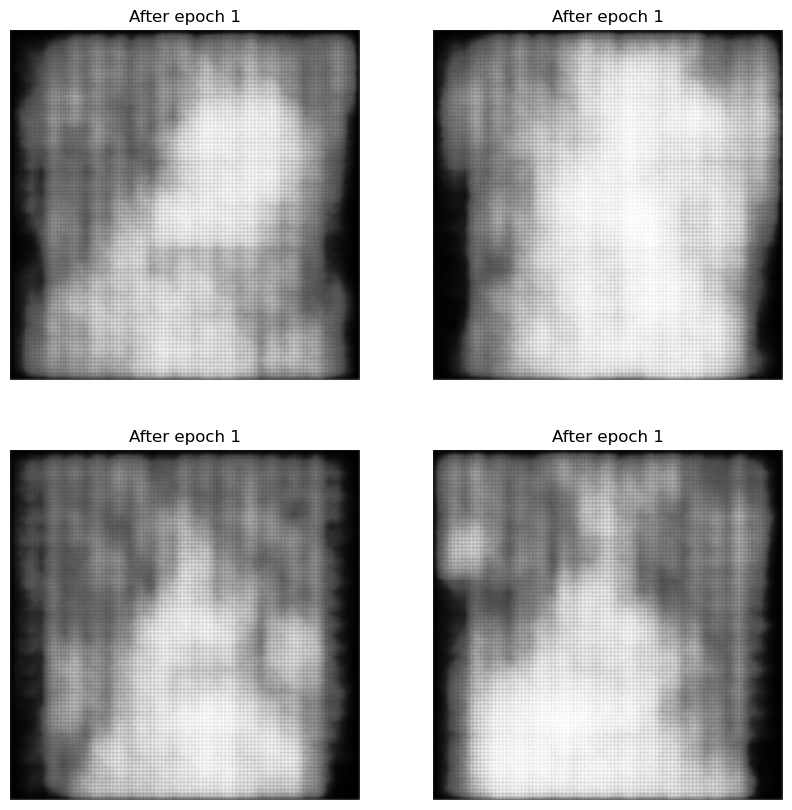

122/122 [==============================] - 458s 3s/step - disc_loss: 0.4202 - gen_loss: 2.0232
Epoch 2/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.4803 - gen_loss: 1.4251

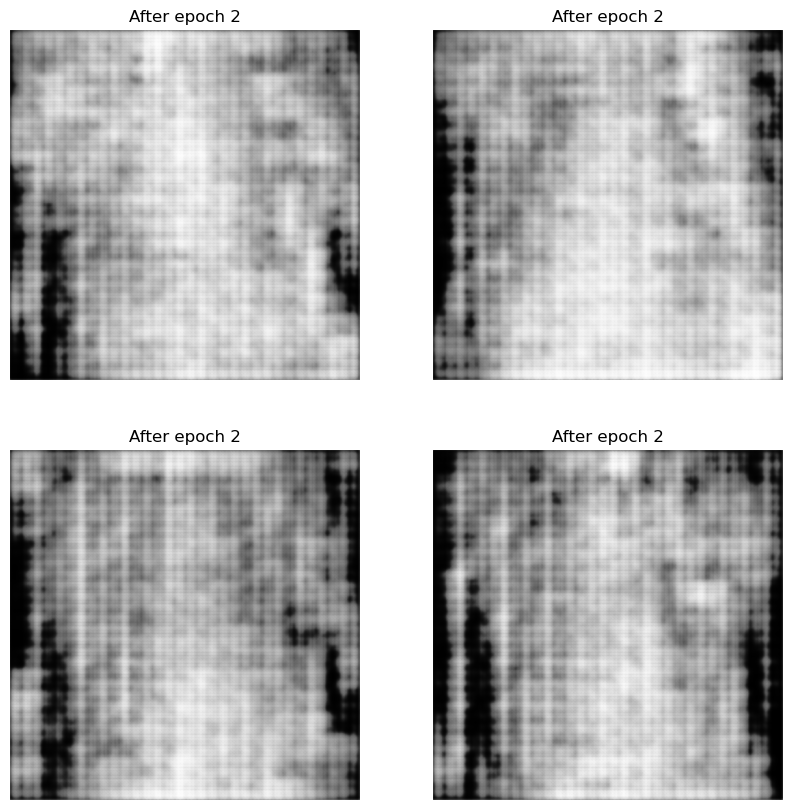

122/122 [==============================] - 397s 3s/step - disc_loss: 0.4803 - gen_loss: 1.4251
Epoch 3/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.4484 - gen_loss: 1.4926

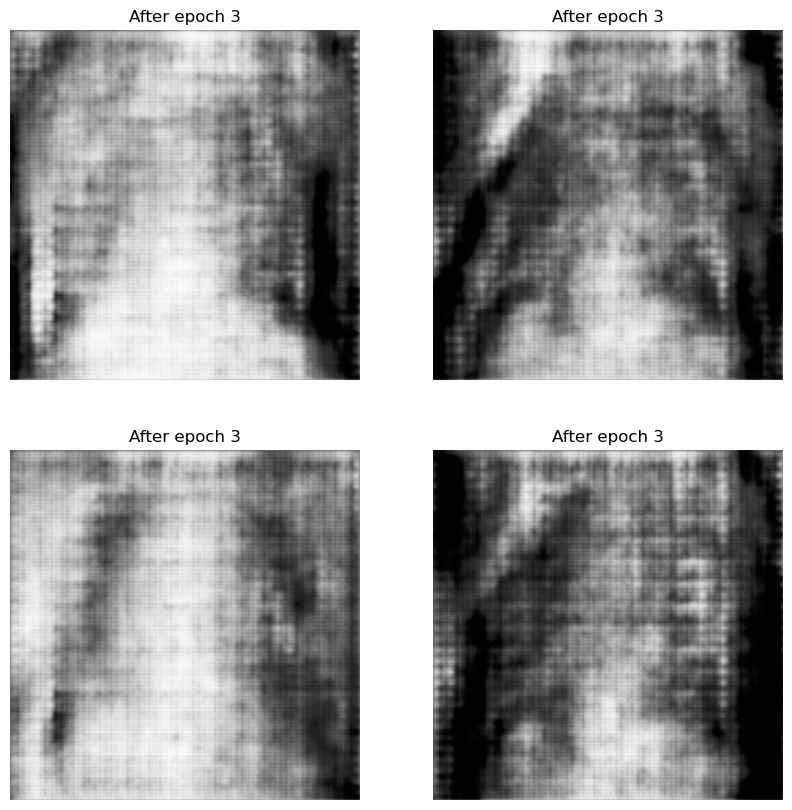

122/122 [==============================] - 400s 3s/step - disc_loss: 0.4484 - gen_loss: 1.4926
Epoch 4/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.4393 - gen_loss: 1.5625

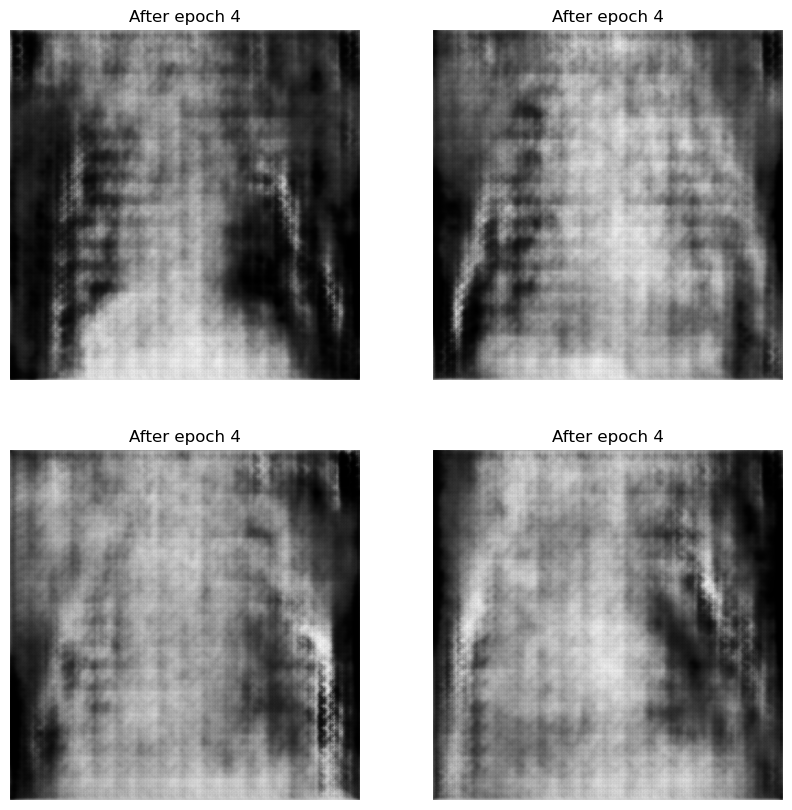

122/122 [==============================] - 404s 3s/step - disc_loss: 0.4393 - gen_loss: 1.5625
Epoch 5/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.4068 - gen_loss: 1.6092

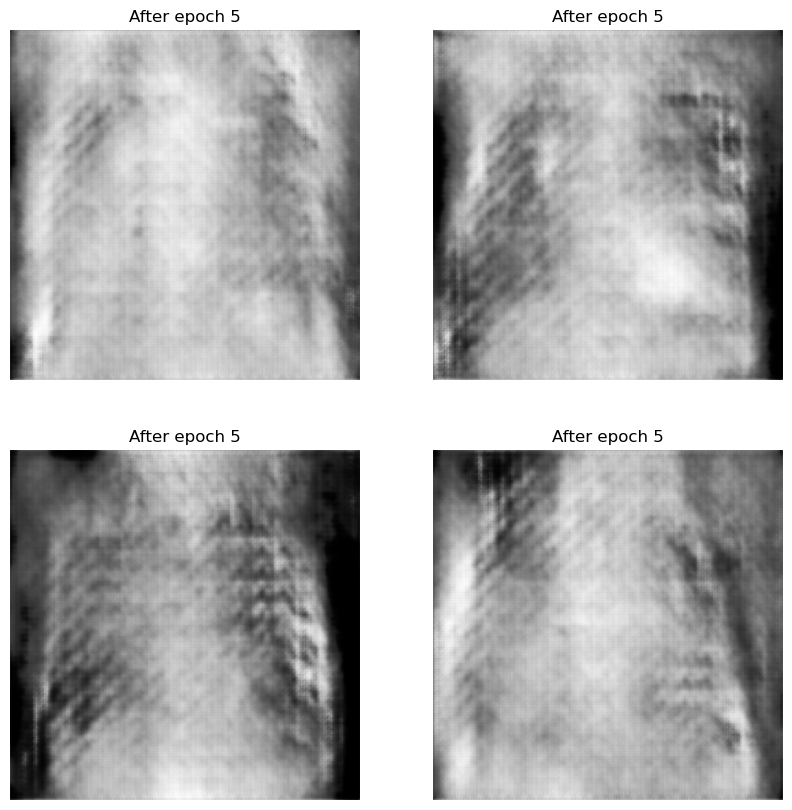

122/122 [==============================] - 400s 3s/step - disc_loss: 0.4068 - gen_loss: 1.6092
Epoch 6/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.3964 - gen_loss: 1.6716

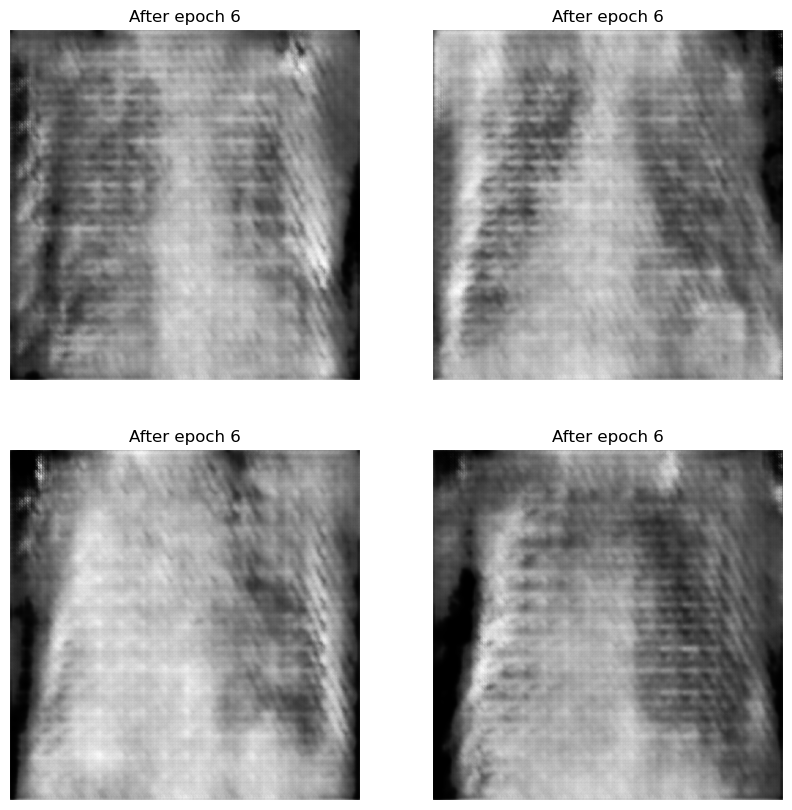

122/122 [==============================] - 393s 3s/step - disc_loss: 0.3964 - gen_loss: 1.6716
Epoch 7/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.3711 - gen_loss: 1.7921

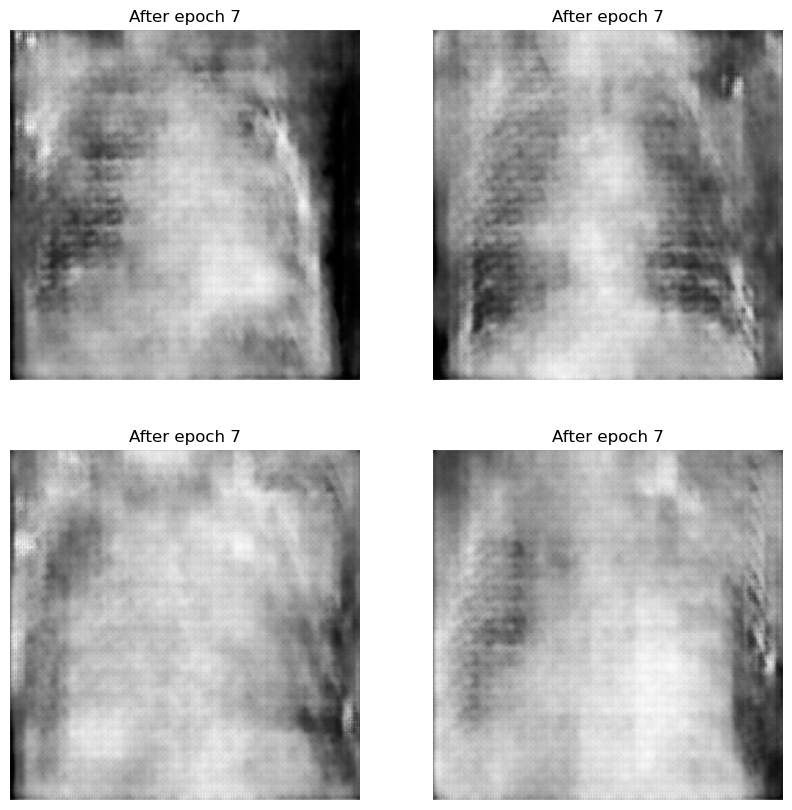

122/122 [==============================] - 398s 3s/step - disc_loss: 0.3711 - gen_loss: 1.7921
Epoch 8/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.3696 - gen_loss: 1.9890

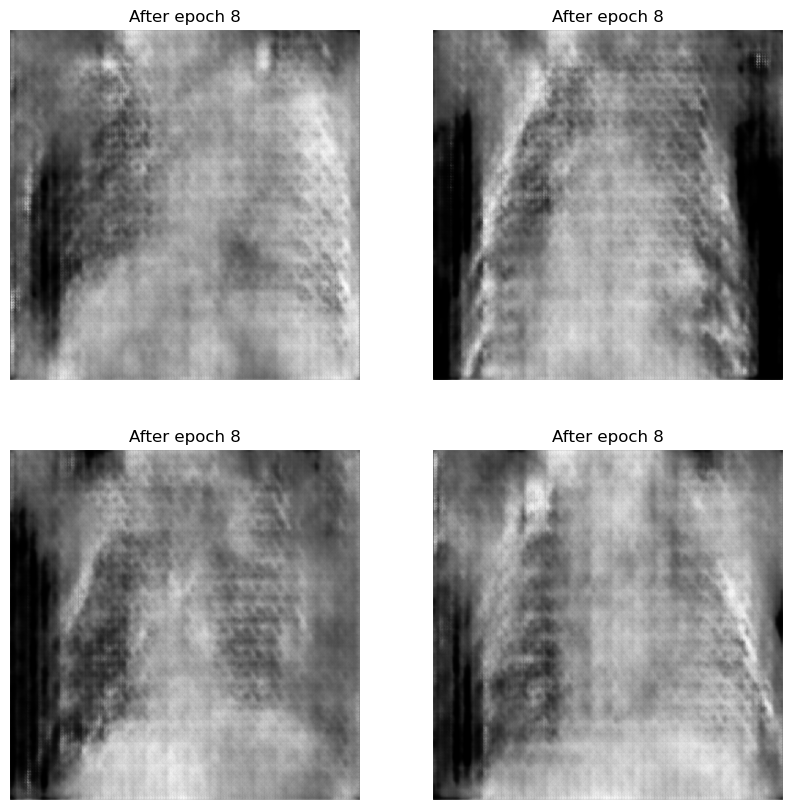

122/122 [==============================] - 400s 3s/step - disc_loss: 0.3696 - gen_loss: 1.9890
Epoch 9/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.3549 - gen_loss: 2.0250

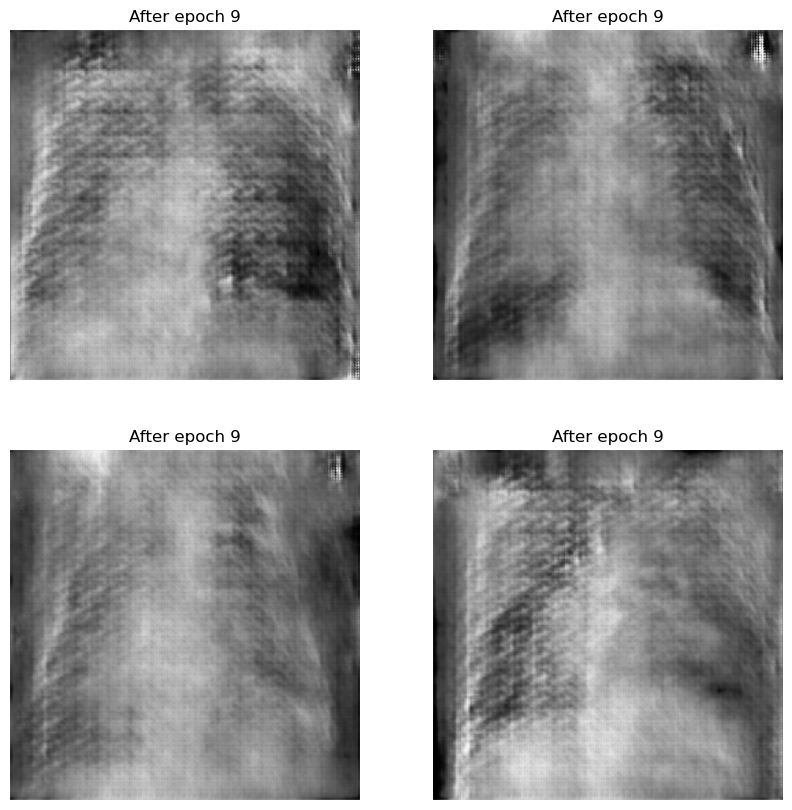

122/122 [==============================] - 395s 3s/step - disc_loss: 0.3549 - gen_loss: 2.0250
Epoch 10/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.3479 - gen_loss: 2.0433

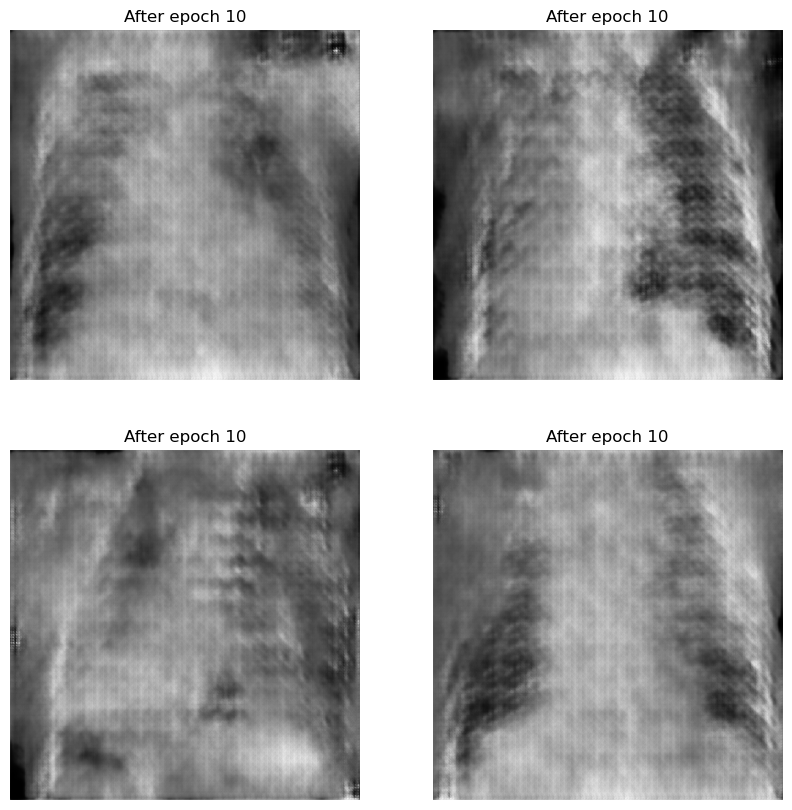

122/122 [==============================] - 395s 3s/step - disc_loss: 0.3479 - gen_loss: 2.0433
Epoch 11/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.3330 - gen_loss: 2.1521

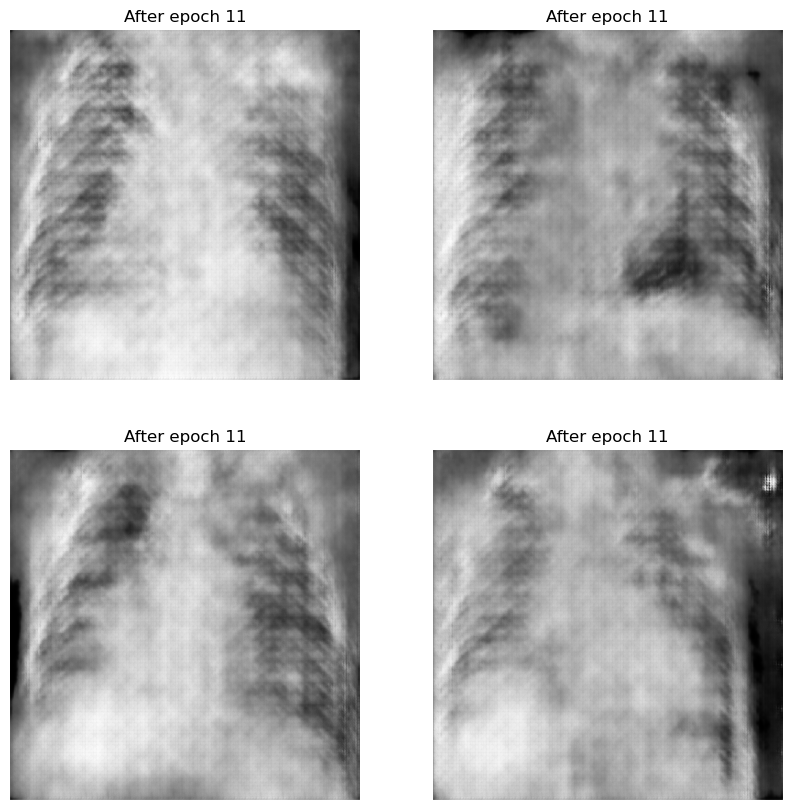

122/122 [==============================] - 397s 3s/step - disc_loss: 0.3330 - gen_loss: 2.1521
Epoch 12/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2959 - gen_loss: 2.3228

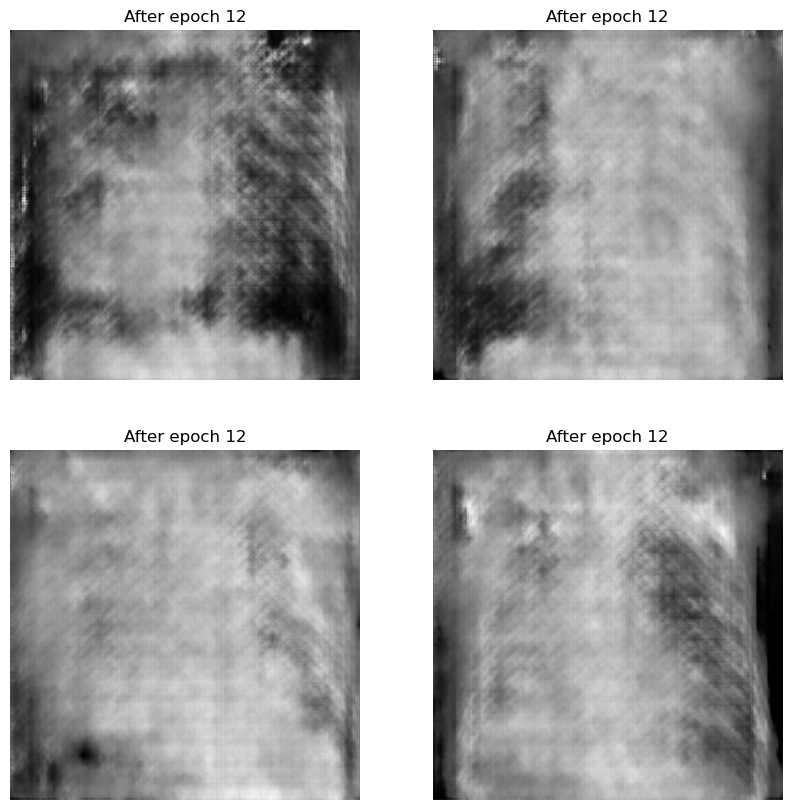

122/122 [==============================] - 396s 3s/step - disc_loss: 0.2959 - gen_loss: 2.3228
Epoch 13/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.3109 - gen_loss: 2.2946

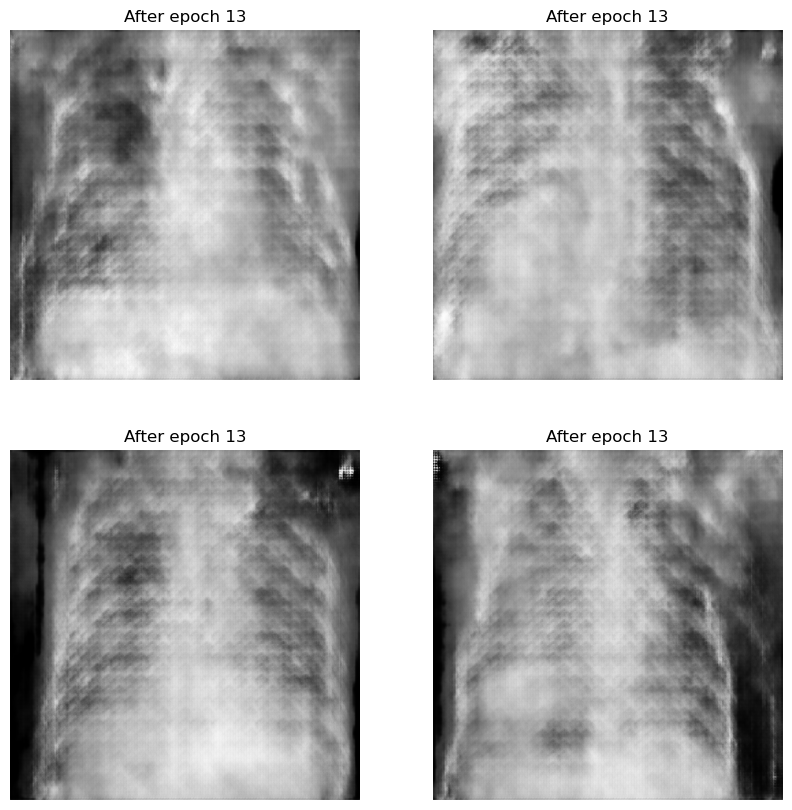

122/122 [==============================] - 400s 3s/step - disc_loss: 0.3109 - gen_loss: 2.2946
Epoch 14/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.3086 - gen_loss: 2.2869

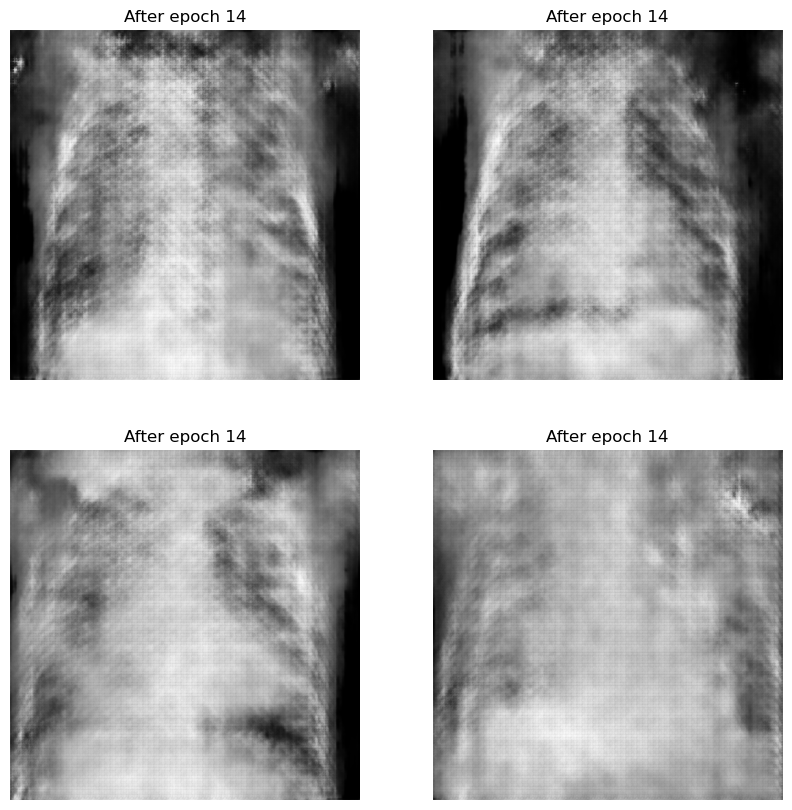

122/122 [==============================] - 397s 3s/step - disc_loss: 0.3086 - gen_loss: 2.2869
Epoch 15/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2954 - gen_loss: 2.3824

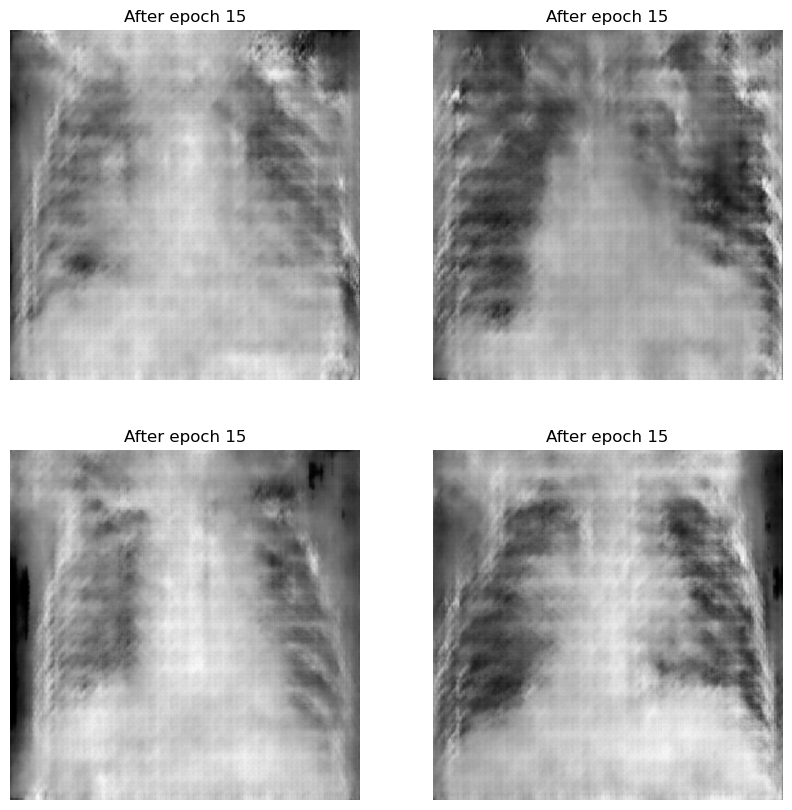

122/122 [==============================] - 396s 3s/step - disc_loss: 0.2954 - gen_loss: 2.3824
Epoch 16/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.3102 - gen_loss: 2.4053

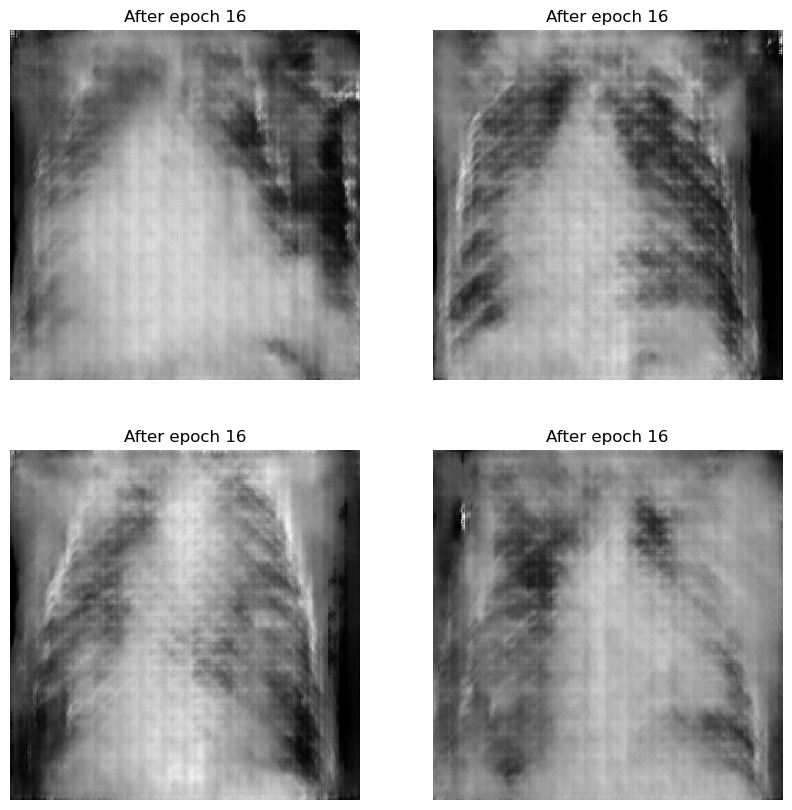

122/122 [==============================] - 397s 3s/step - disc_loss: 0.3102 - gen_loss: 2.4053
Epoch 17/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2875 - gen_loss: 2.4895

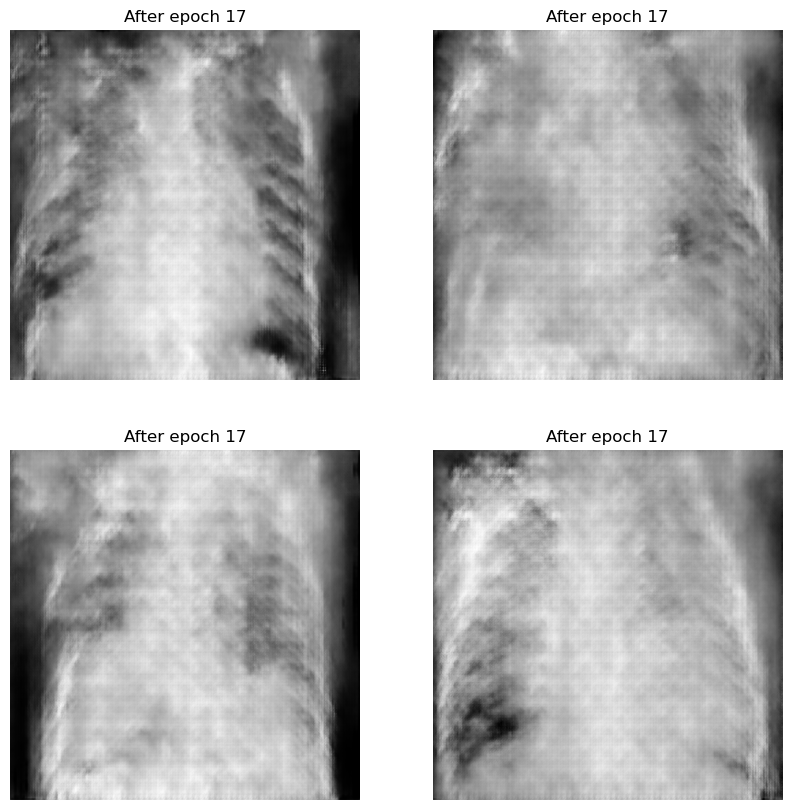

122/122 [==============================] - 397s 3s/step - disc_loss: 0.2875 - gen_loss: 2.4895
Epoch 18/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2896 - gen_loss: 2.3818

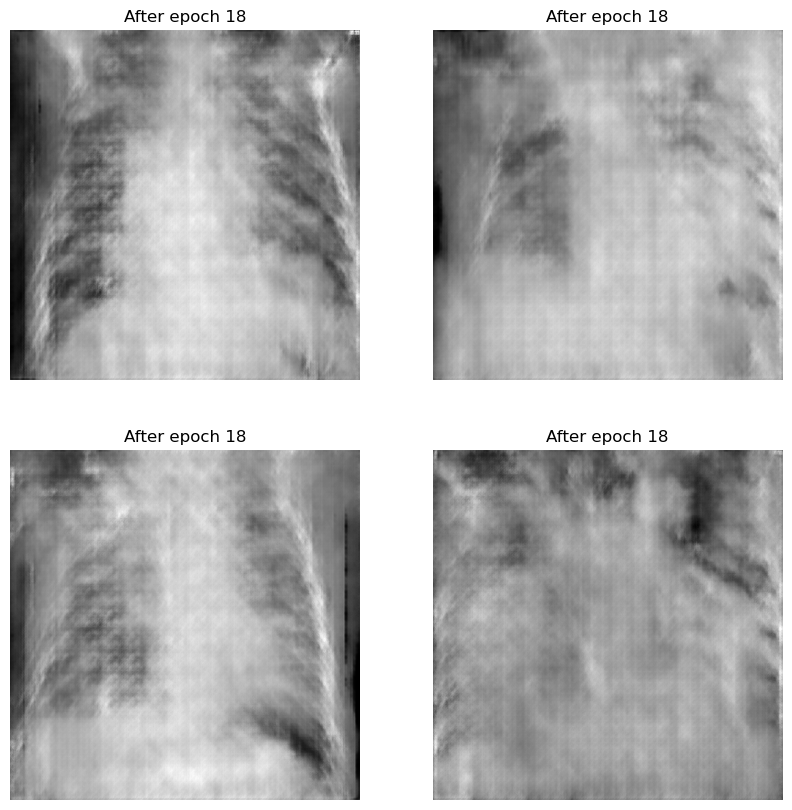

122/122 [==============================] - 401s 3s/step - disc_loss: 0.2896 - gen_loss: 2.3818
Epoch 19/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2939 - gen_loss: 2.4720

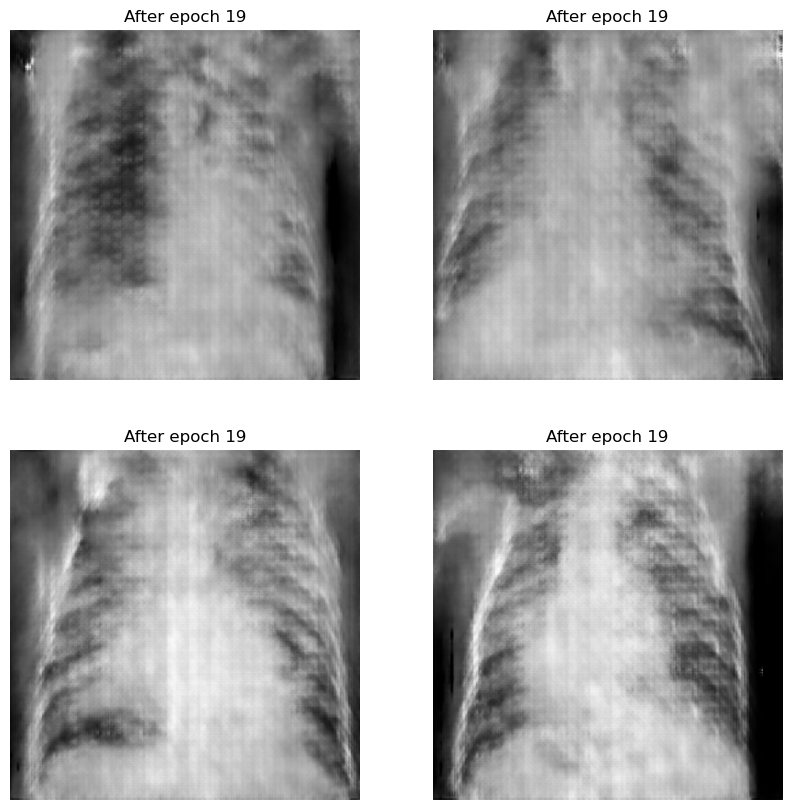

122/122 [==============================] - 397s 3s/step - disc_loss: 0.2939 - gen_loss: 2.4720
Epoch 20/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2791 - gen_loss: 2.6056

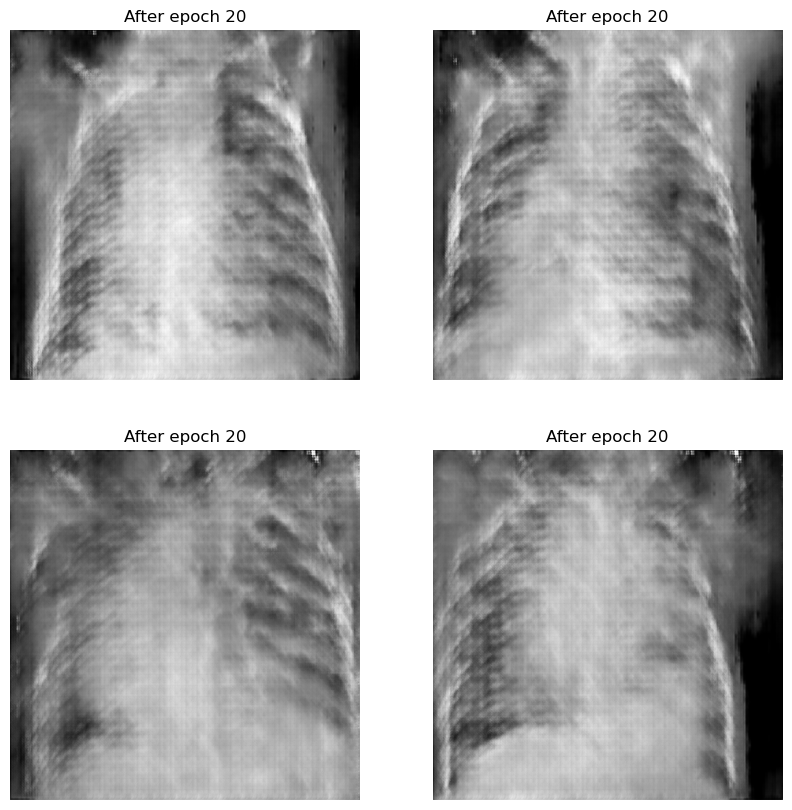

122/122 [==============================] - 399s 3s/step - disc_loss: 0.2791 - gen_loss: 2.6056
Epoch 21/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2795 - gen_loss: 2.6281

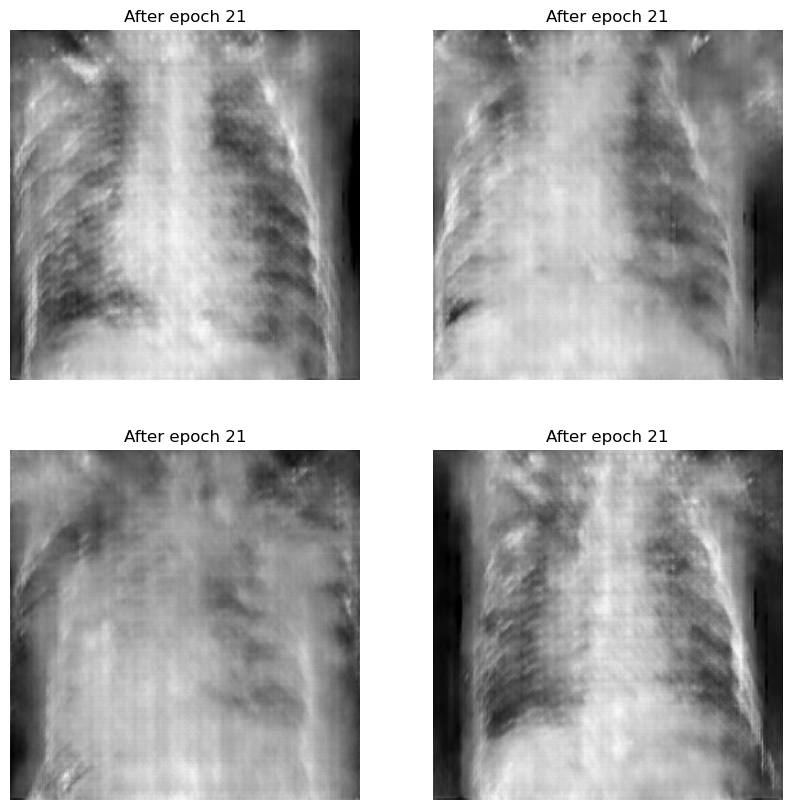

122/122 [==============================] - 392s 3s/step - disc_loss: 0.2795 - gen_loss: 2.6281
Epoch 22/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2818 - gen_loss: 2.6716

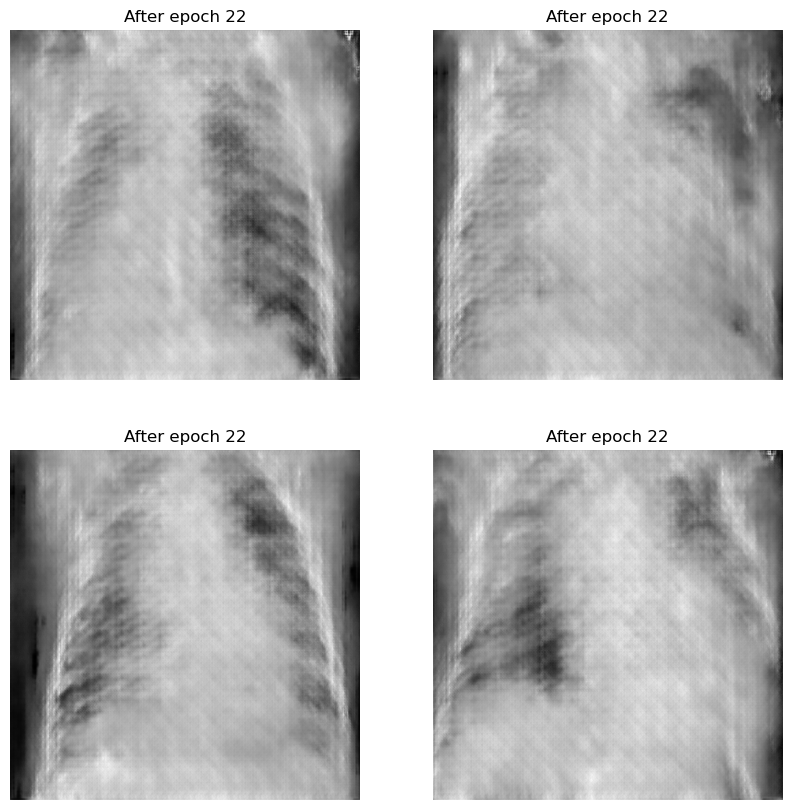

122/122 [==============================] - 395s 3s/step - disc_loss: 0.2818 - gen_loss: 2.6716
Epoch 23/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2794 - gen_loss: 2.5993

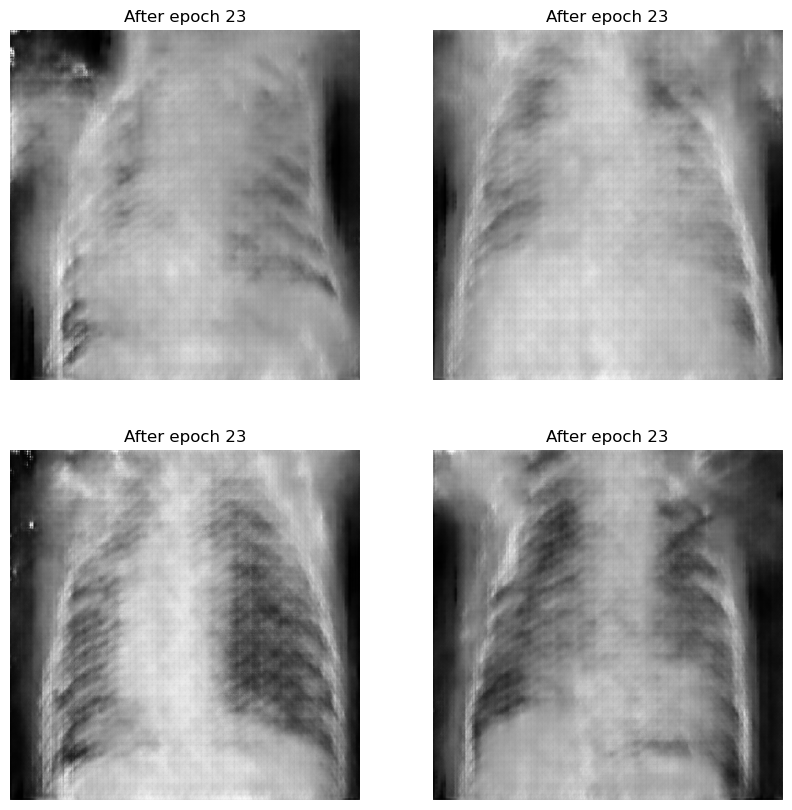

122/122 [==============================] - 397s 3s/step - disc_loss: 0.2794 - gen_loss: 2.5993
Epoch 24/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2844 - gen_loss: 2.6219

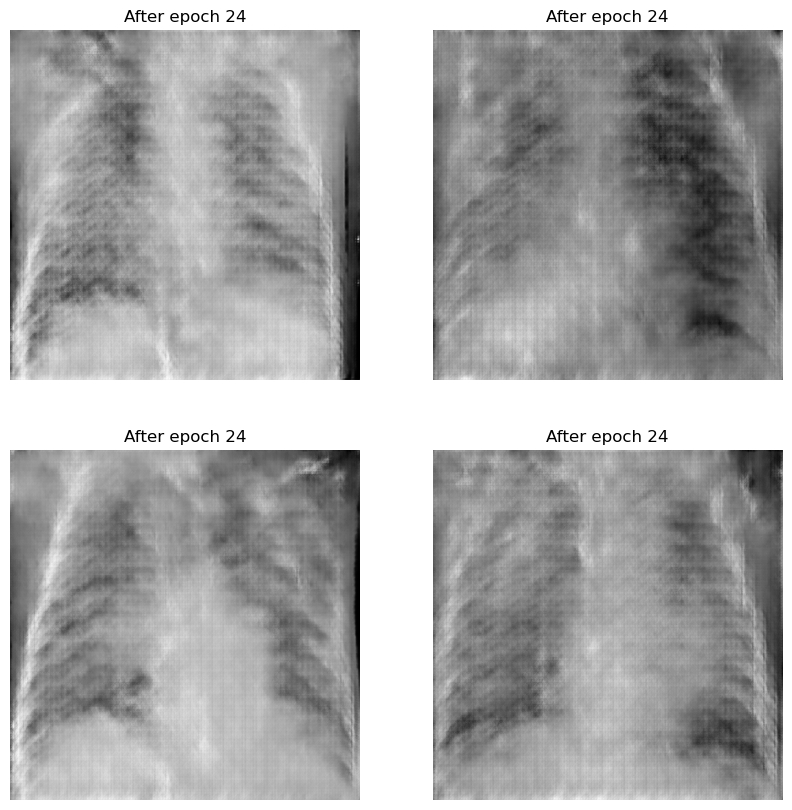

122/122 [==============================] - 394s 3s/step - disc_loss: 0.2844 - gen_loss: 2.6219
Epoch 25/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2787 - gen_loss: 2.7748

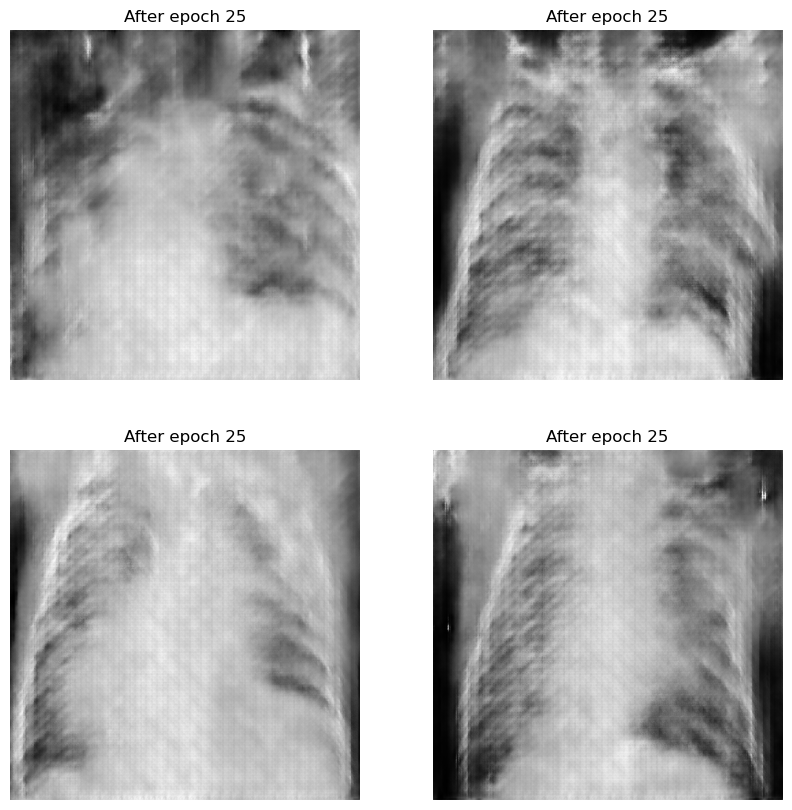

122/122 [==============================] - 397s 3s/step - disc_loss: 0.2787 - gen_loss: 2.7748
Epoch 26/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2566 - gen_loss: 2.6975

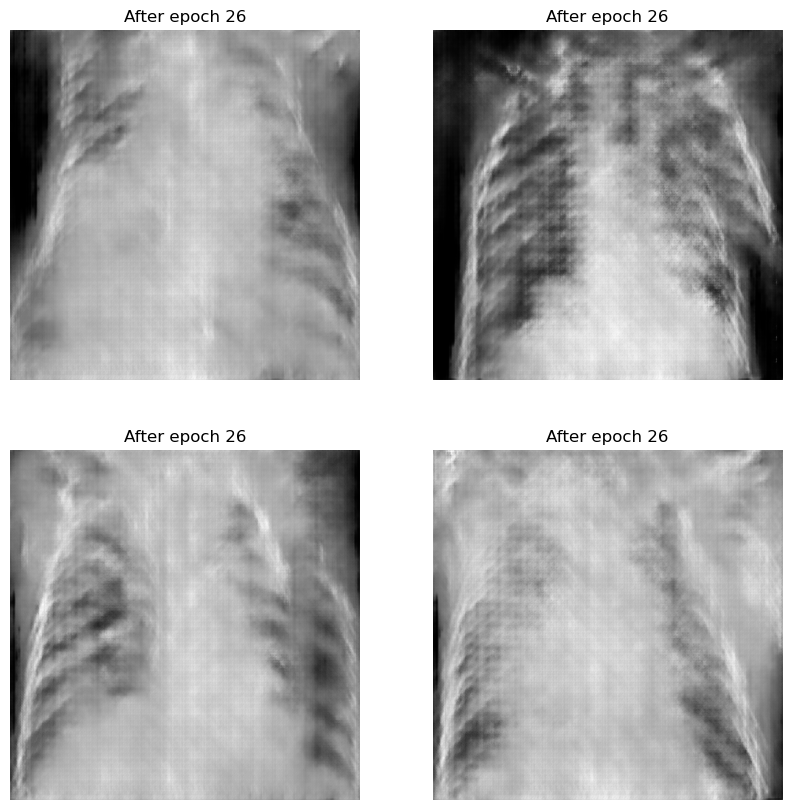

122/122 [==============================] - 396s 3s/step - disc_loss: 0.2566 - gen_loss: 2.6975
Epoch 27/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2693 - gen_loss: 2.7686

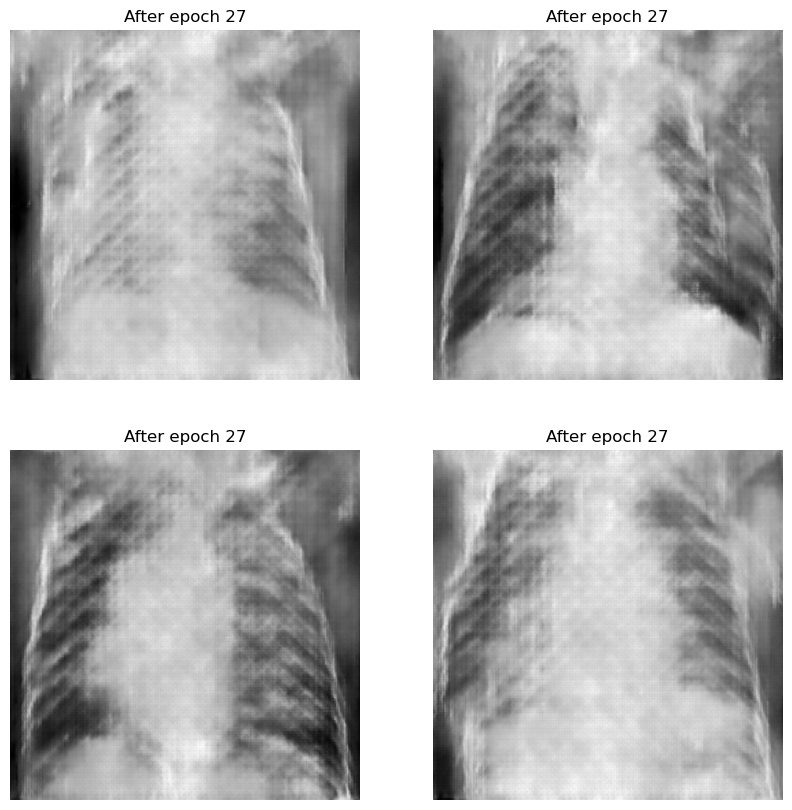

122/122 [==============================] - 395s 3s/step - disc_loss: 0.2693 - gen_loss: 2.7686
Epoch 28/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2668 - gen_loss: 2.8986

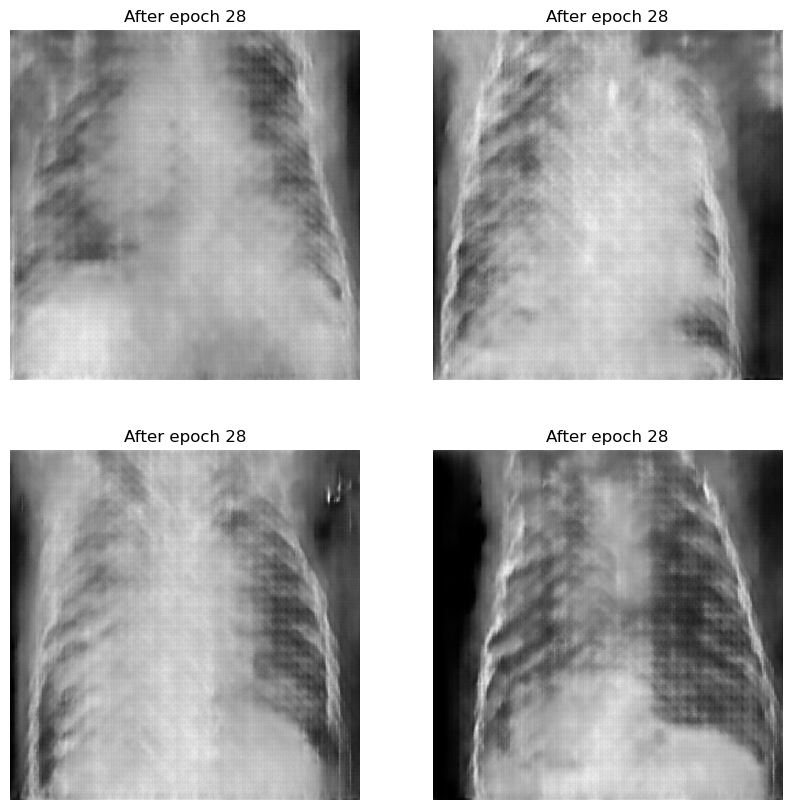

122/122 [==============================] - 395s 3s/step - disc_loss: 0.2668 - gen_loss: 2.8986
Epoch 29/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2641 - gen_loss: 2.7785

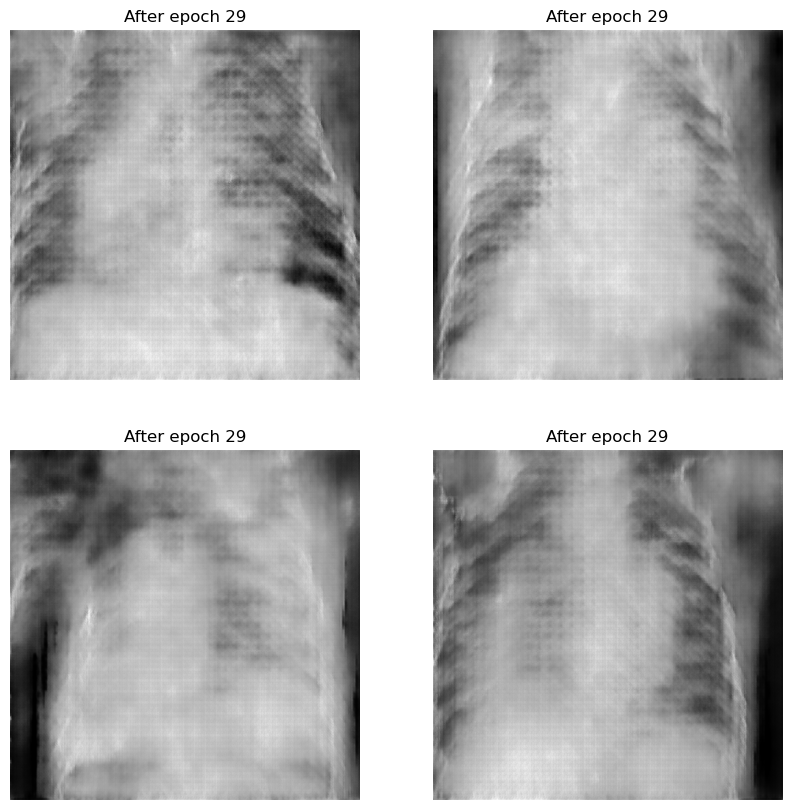

122/122 [==============================] - 393s 3s/step - disc_loss: 0.2641 - gen_loss: 2.7785
Epoch 30/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2477 - gen_loss: 2.8665

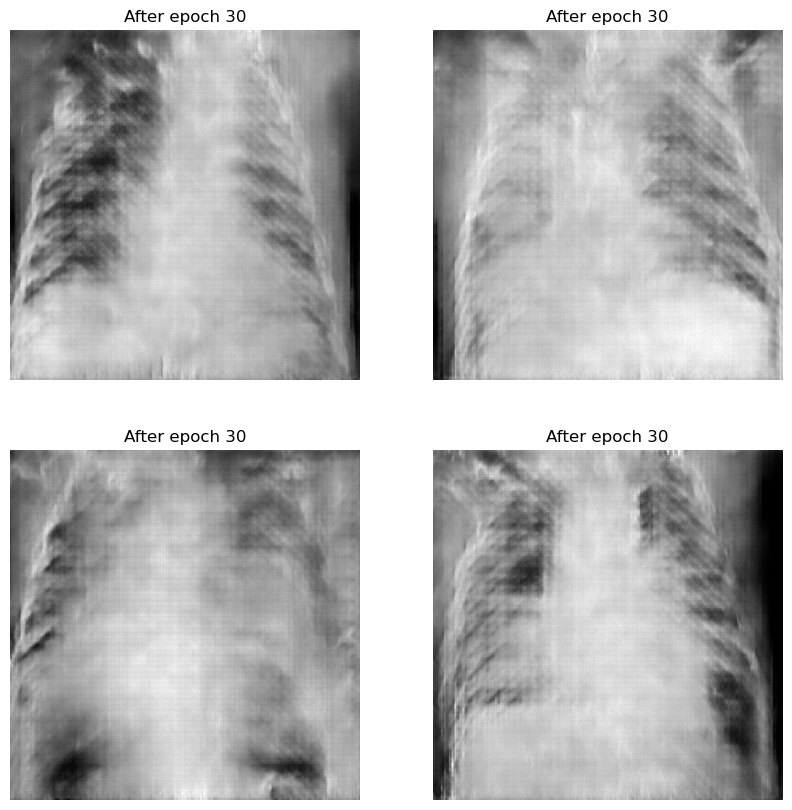

122/122 [==============================] - 394s 3s/step - disc_loss: 0.2477 - gen_loss: 2.8665
Epoch 31/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2331 - gen_loss: 2.9819

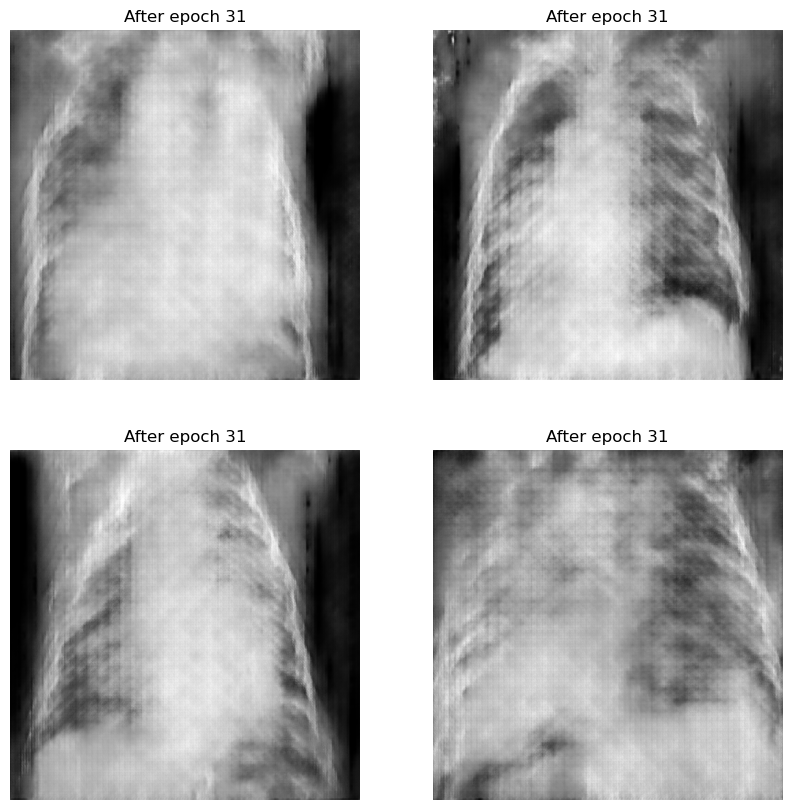

122/122 [==============================] - 394s 3s/step - disc_loss: 0.2331 - gen_loss: 2.9819
Epoch 32/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2392 - gen_loss: 3.1384

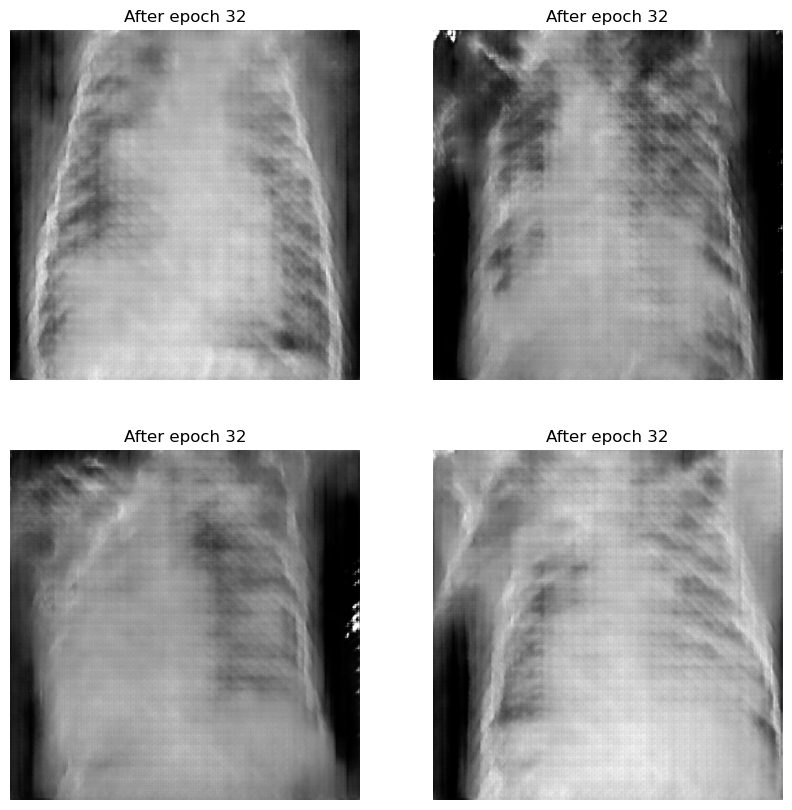

122/122 [==============================] - 390s 3s/step - disc_loss: 0.2392 - gen_loss: 3.1384
Epoch 33/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2371 - gen_loss: 2.9525

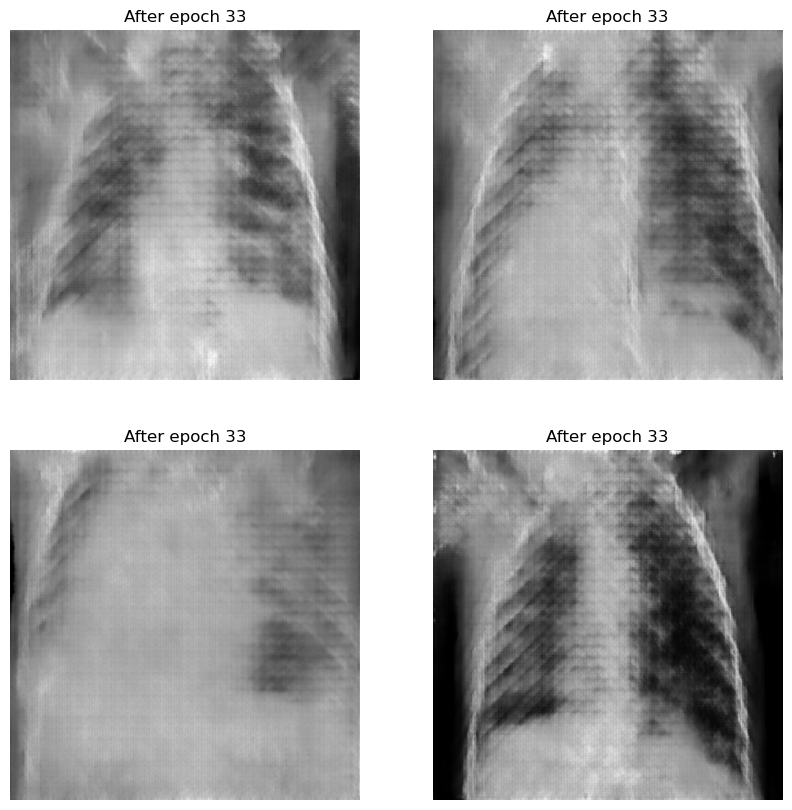

122/122 [==============================] - 394s 3s/step - disc_loss: 0.2371 - gen_loss: 2.9525
Epoch 34/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2220 - gen_loss: 3.0639

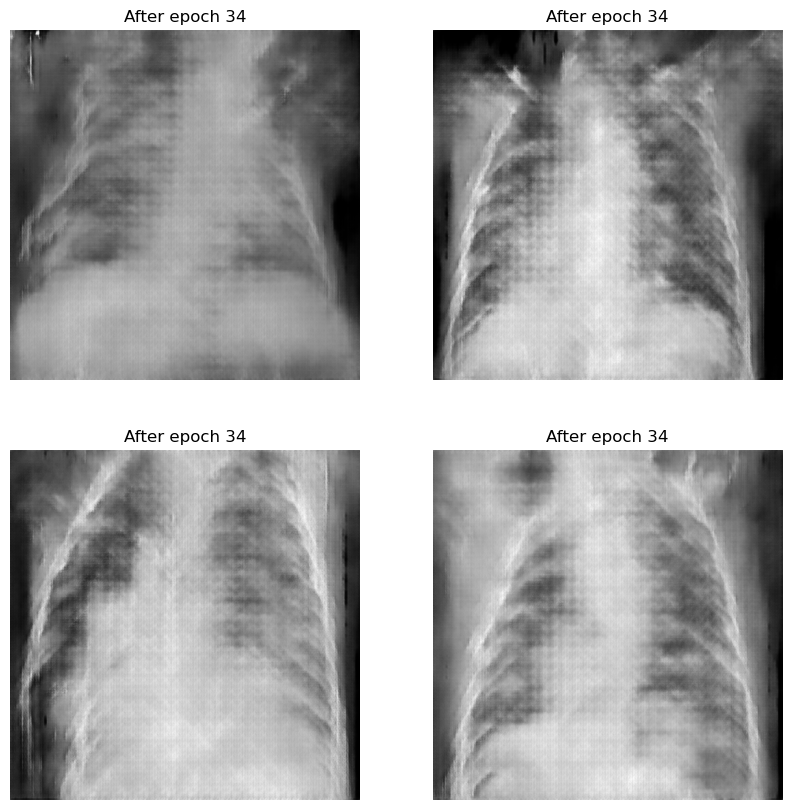

122/122 [==============================] - 398s 3s/step - disc_loss: 0.2220 - gen_loss: 3.0639
Epoch 35/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2320 - gen_loss: 3.1281

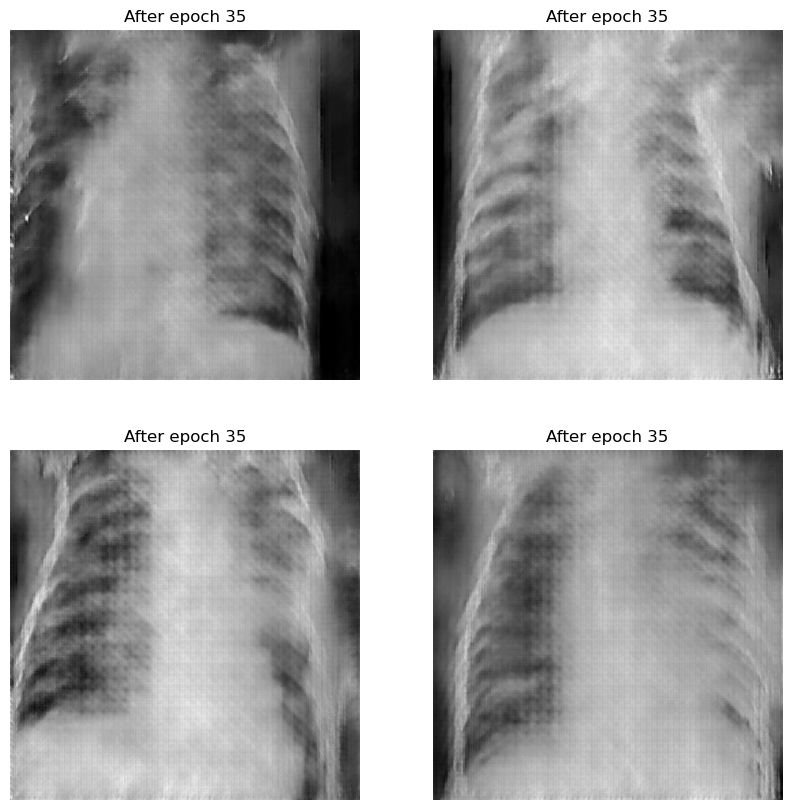

122/122 [==============================] - 396s 3s/step - disc_loss: 0.2320 - gen_loss: 3.1281
Epoch 36/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2205 - gen_loss: 3.2201

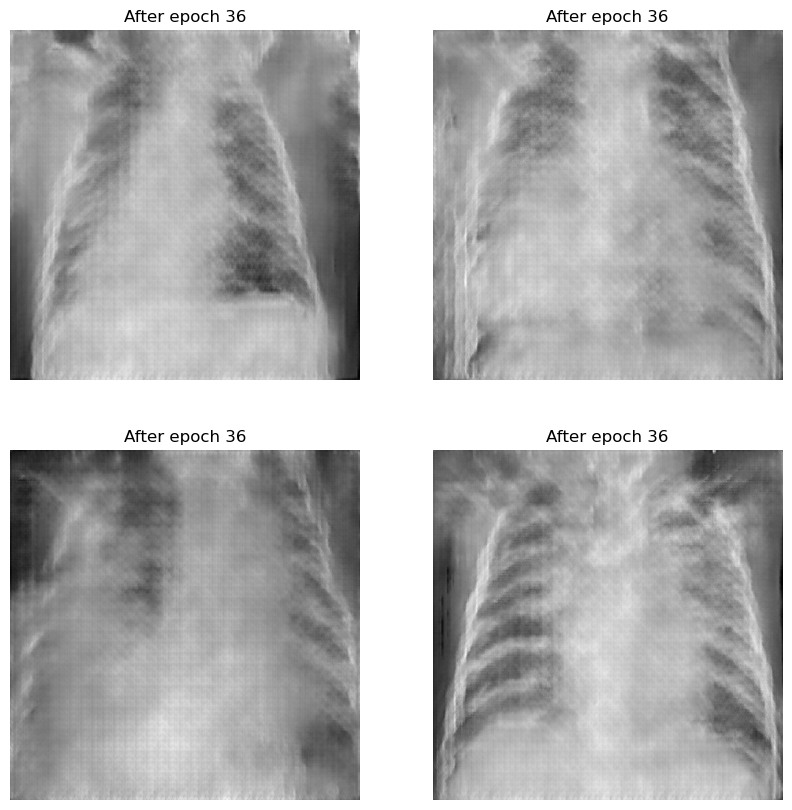

122/122 [==============================] - 392s 3s/step - disc_loss: 0.2205 - gen_loss: 3.2201
Epoch 37/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2277 - gen_loss: 3.3062

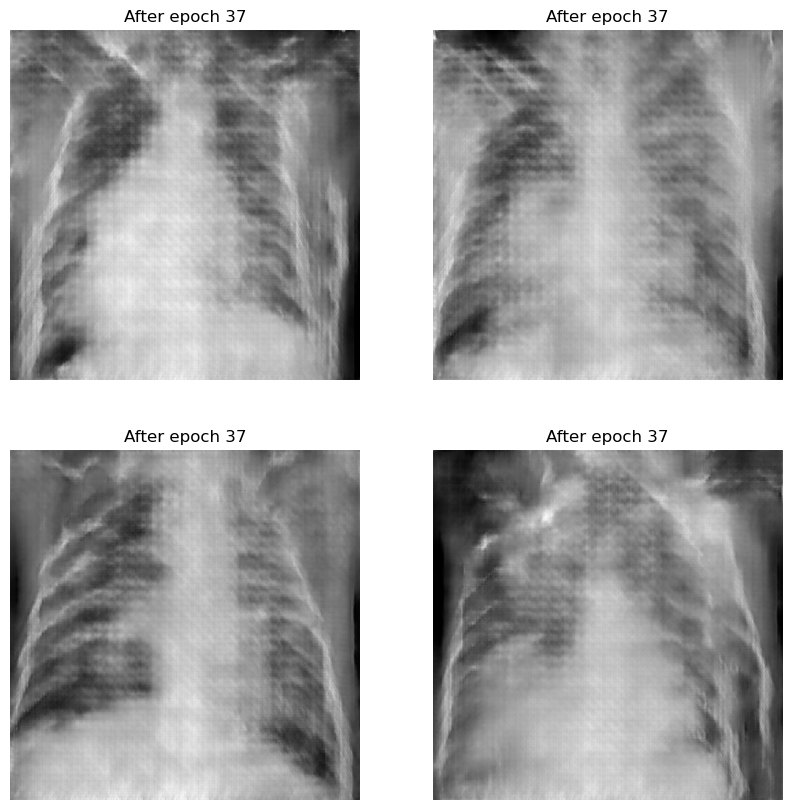

122/122 [==============================] - 393s 3s/step - disc_loss: 0.2277 - gen_loss: 3.3062
Epoch 38/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2086 - gen_loss: 3.4067

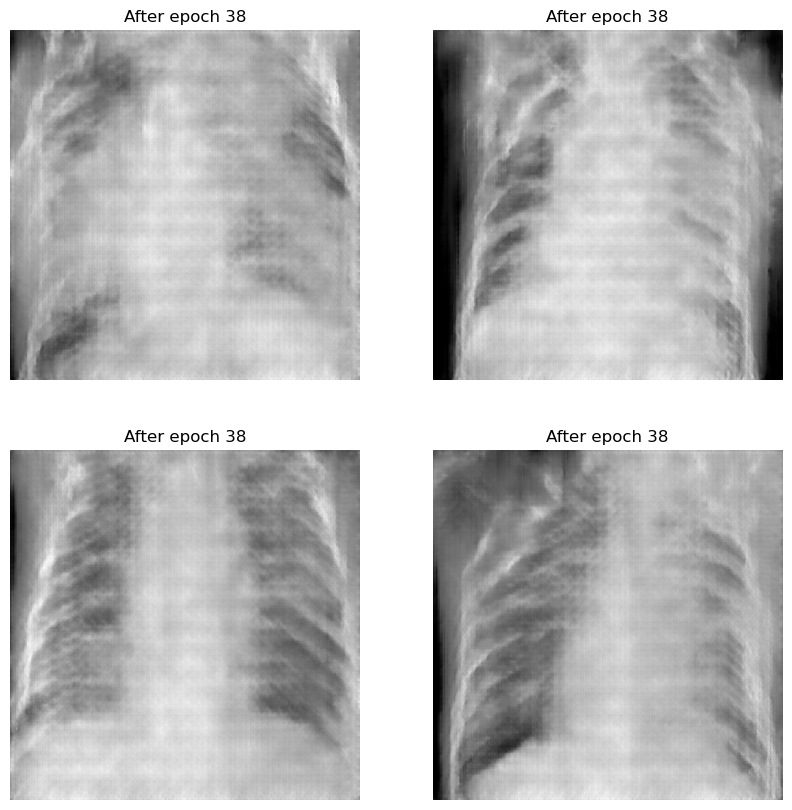

122/122 [==============================] - 391s 3s/step - disc_loss: 0.2086 - gen_loss: 3.4067
Epoch 39/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2209 - gen_loss: 3.4349

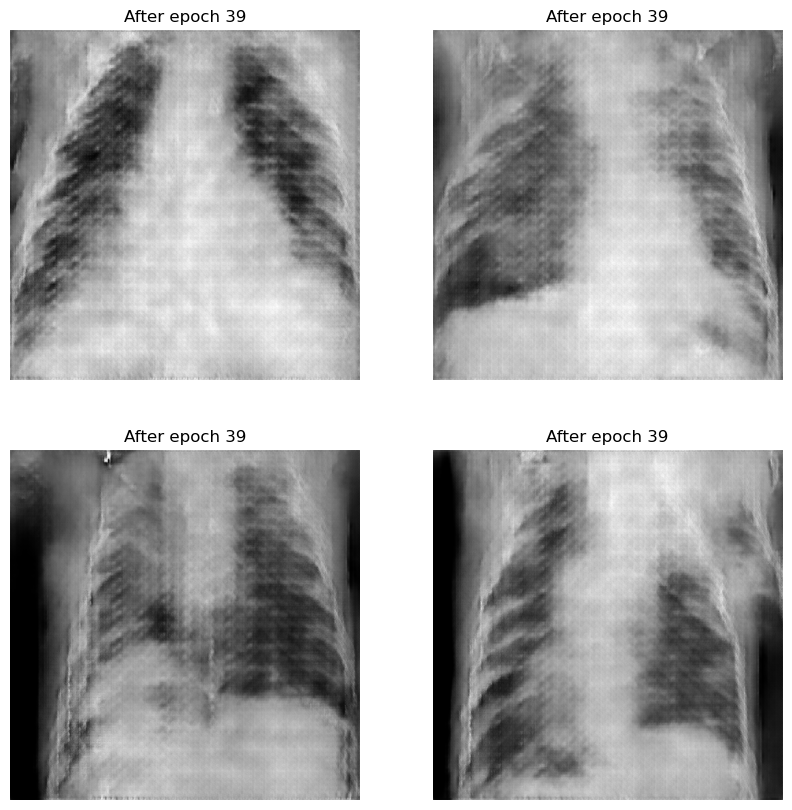

122/122 [==============================] - 390s 3s/step - disc_loss: 0.2209 - gen_loss: 3.4349
Epoch 40/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2196 - gen_loss: 3.3985

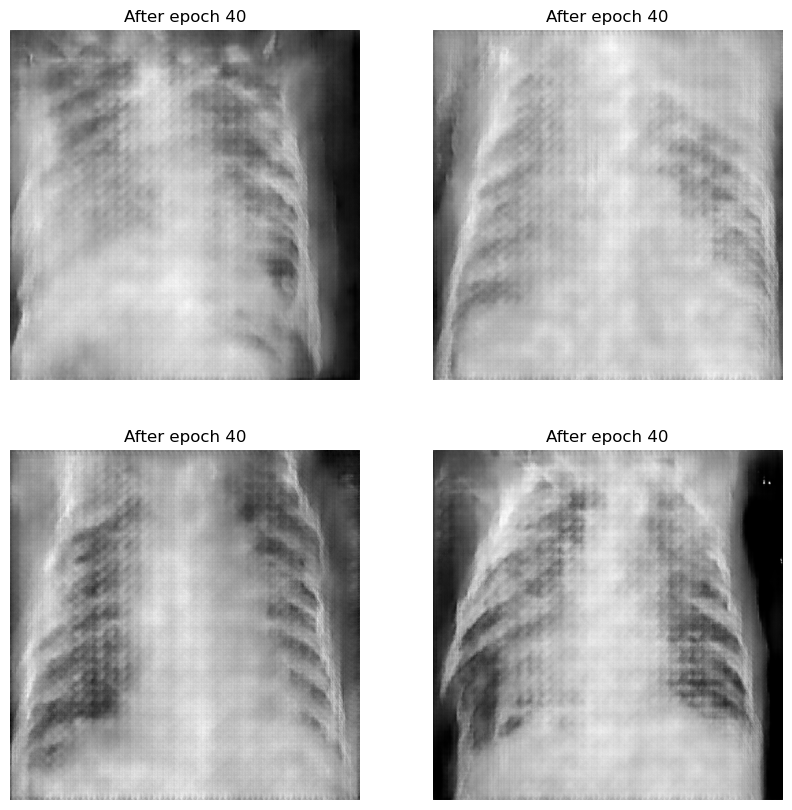

122/122 [==============================] - 390s 3s/step - disc_loss: 0.2196 - gen_loss: 3.3985
Epoch 41/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2017 - gen_loss: 3.4411

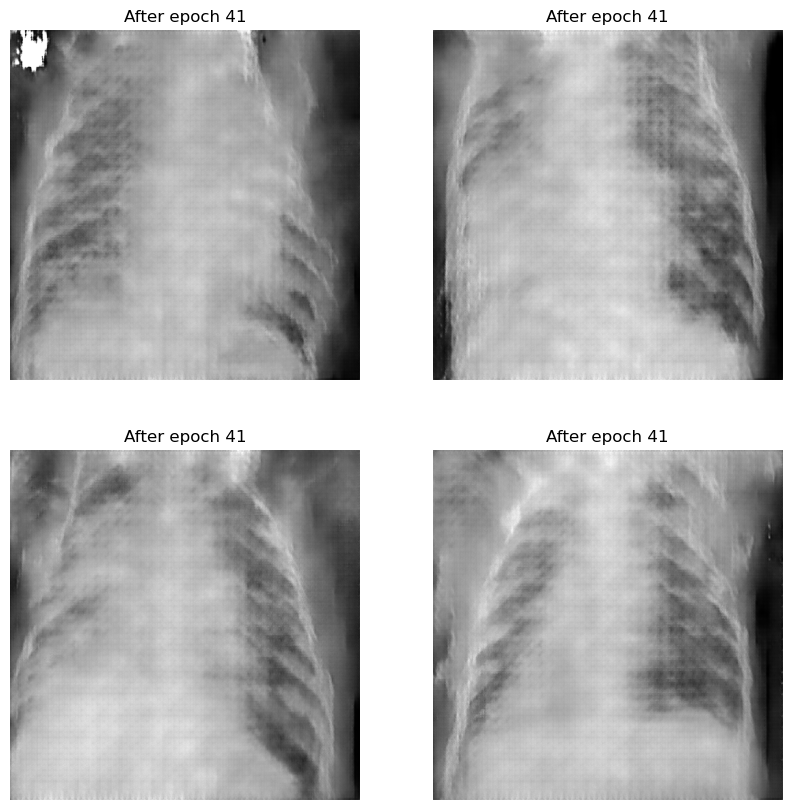

122/122 [==============================] - 390s 3s/step - disc_loss: 0.2017 - gen_loss: 3.4411
Epoch 42/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2065 - gen_loss: 3.4609

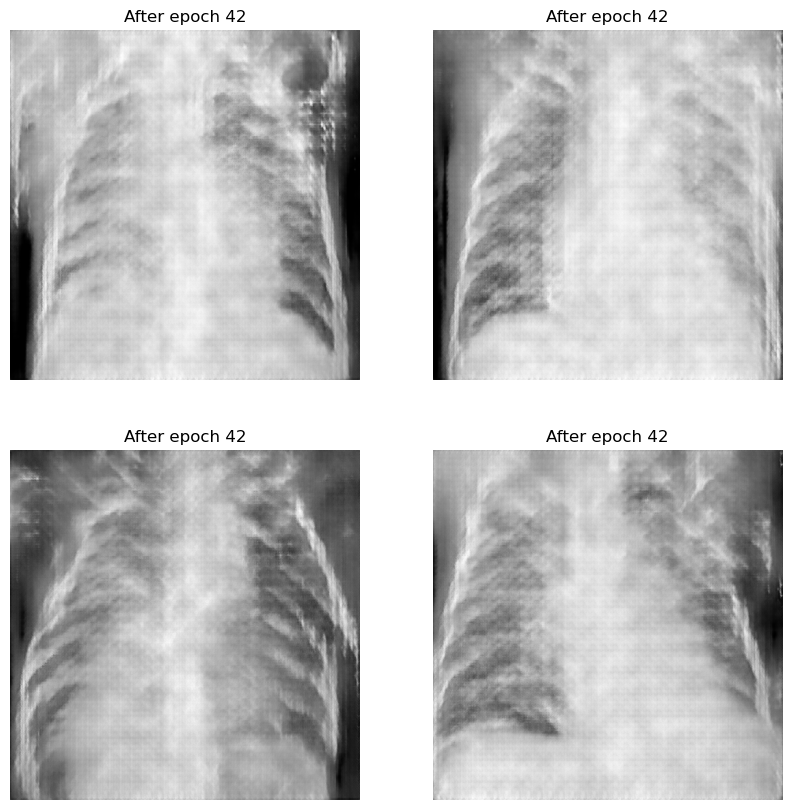

122/122 [==============================] - 393s 3s/step - disc_loss: 0.2065 - gen_loss: 3.4609
Epoch 43/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2355 - gen_loss: 3.3852

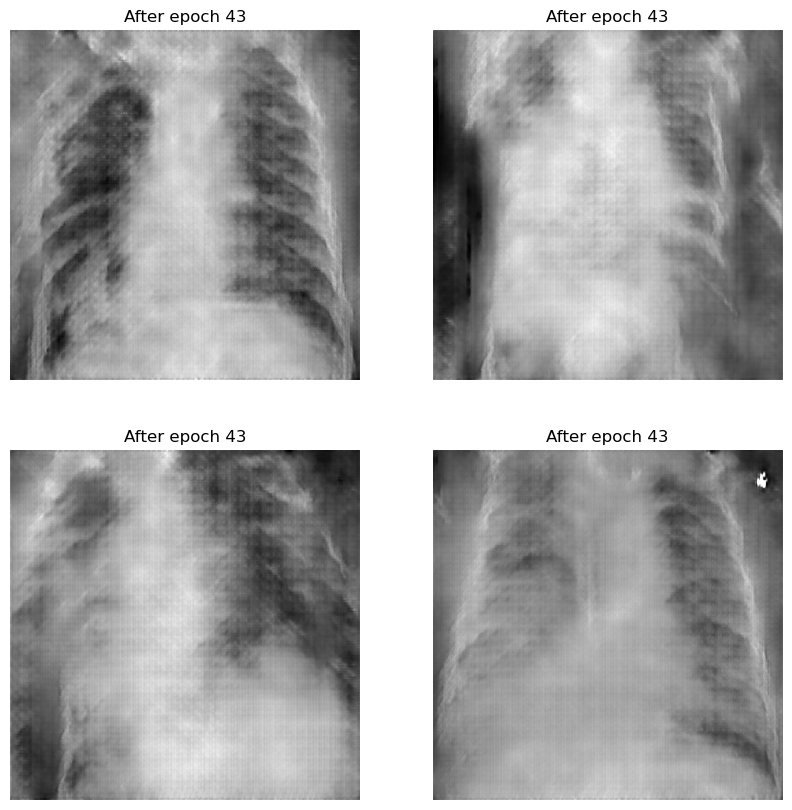

122/122 [==============================] - 392s 3s/step - disc_loss: 0.2355 - gen_loss: 3.3852
Epoch 44/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.1915 - gen_loss: 3.4560

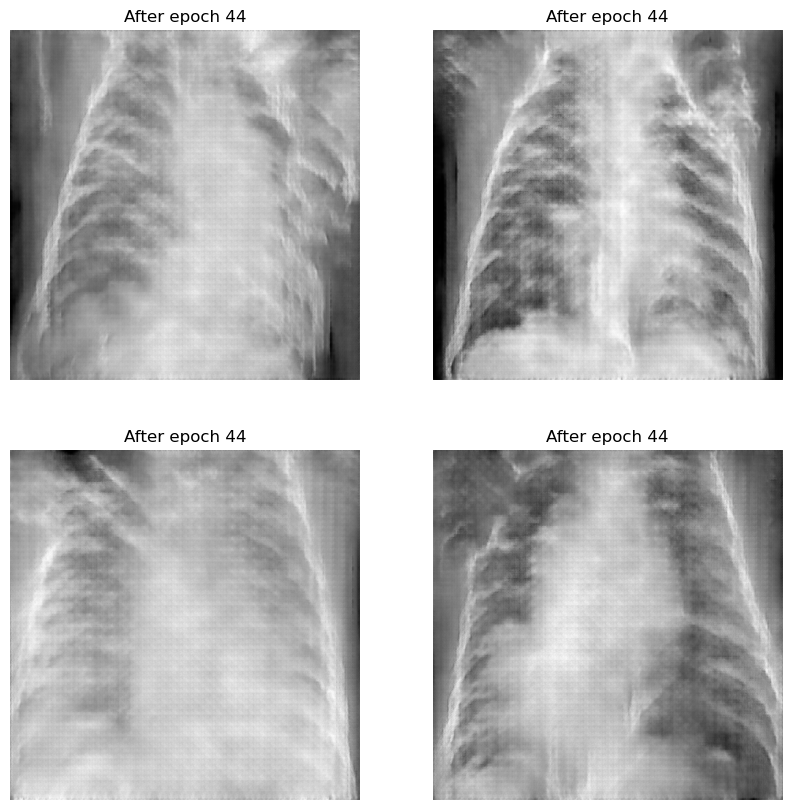

122/122 [==============================] - 391s 3s/step - disc_loss: 0.1915 - gen_loss: 3.4560
Epoch 45/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.1989 - gen_loss: 3.7105

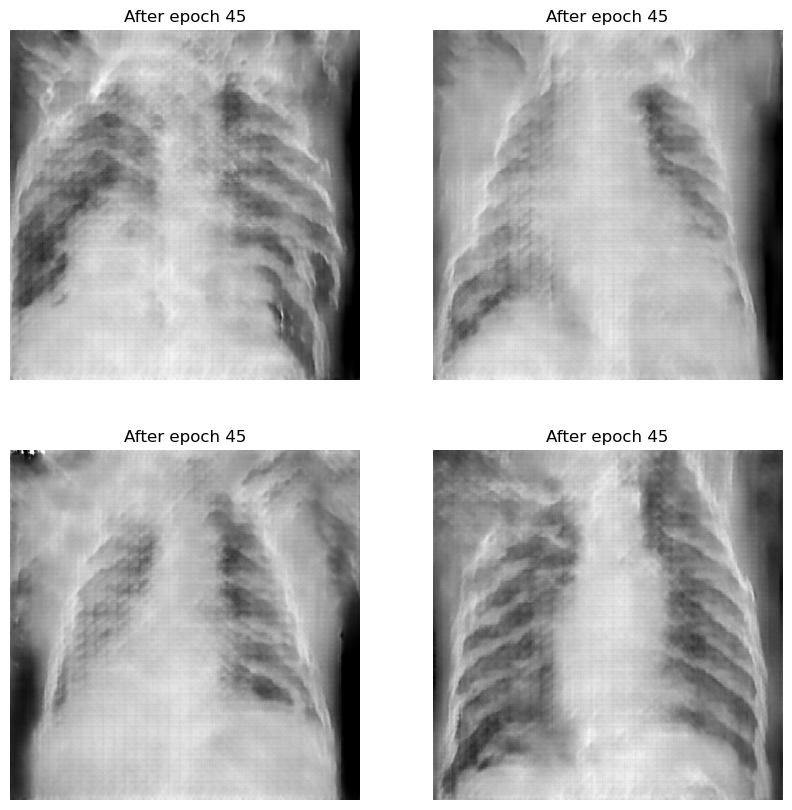

122/122 [==============================] - 392s 3s/step - disc_loss: 0.1989 - gen_loss: 3.7105
Epoch 46/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2129 - gen_loss: 3.5690

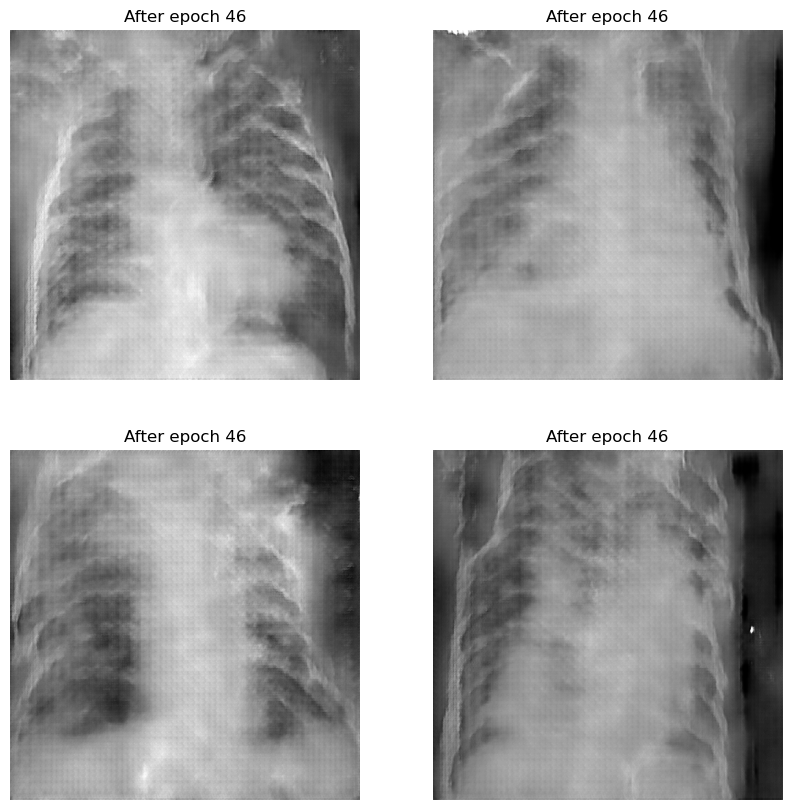

122/122 [==============================] - 391s 3s/step - disc_loss: 0.2129 - gen_loss: 3.5690
Epoch 47/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2122 - gen_loss: 3.4655

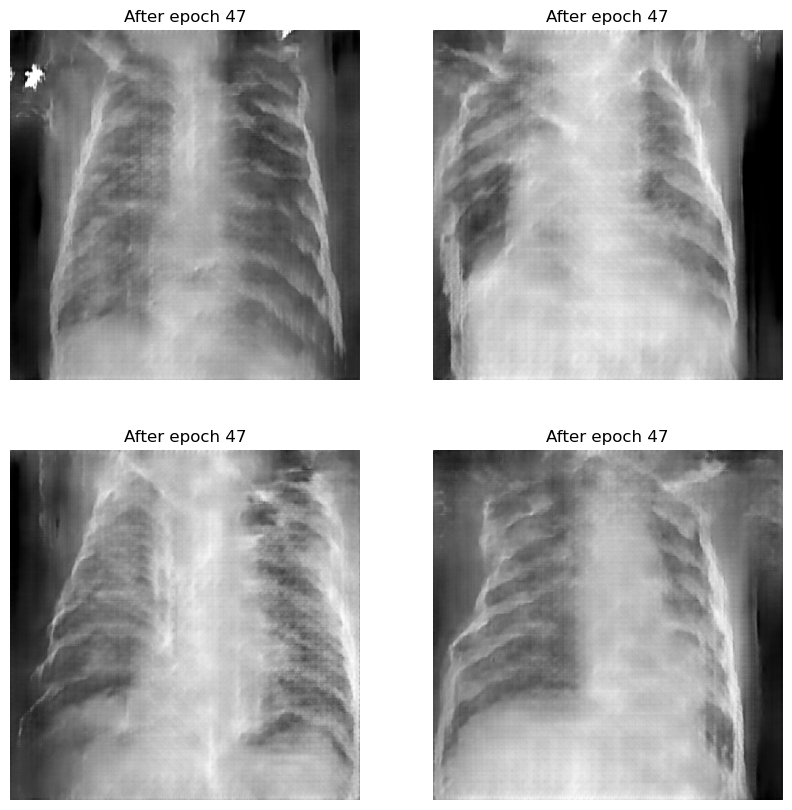

122/122 [==============================] - 389s 3s/step - disc_loss: 0.2122 - gen_loss: 3.4655
Epoch 48/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2080 - gen_loss: 3.4118

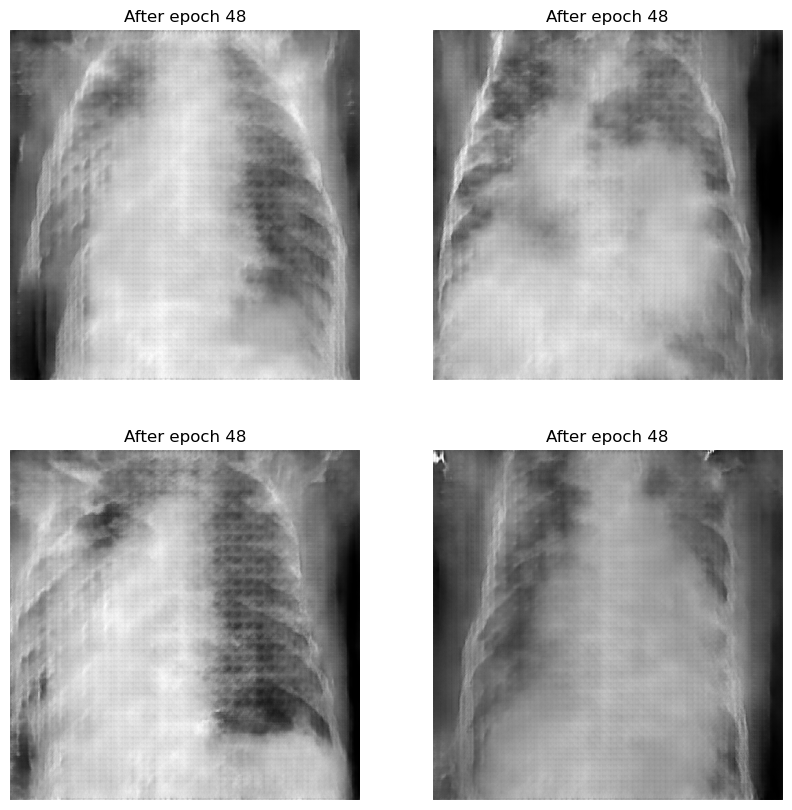

122/122 [==============================] - 392s 3s/step - disc_loss: 0.2080 - gen_loss: 3.4118
Epoch 49/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2137 - gen_loss: 3.5503

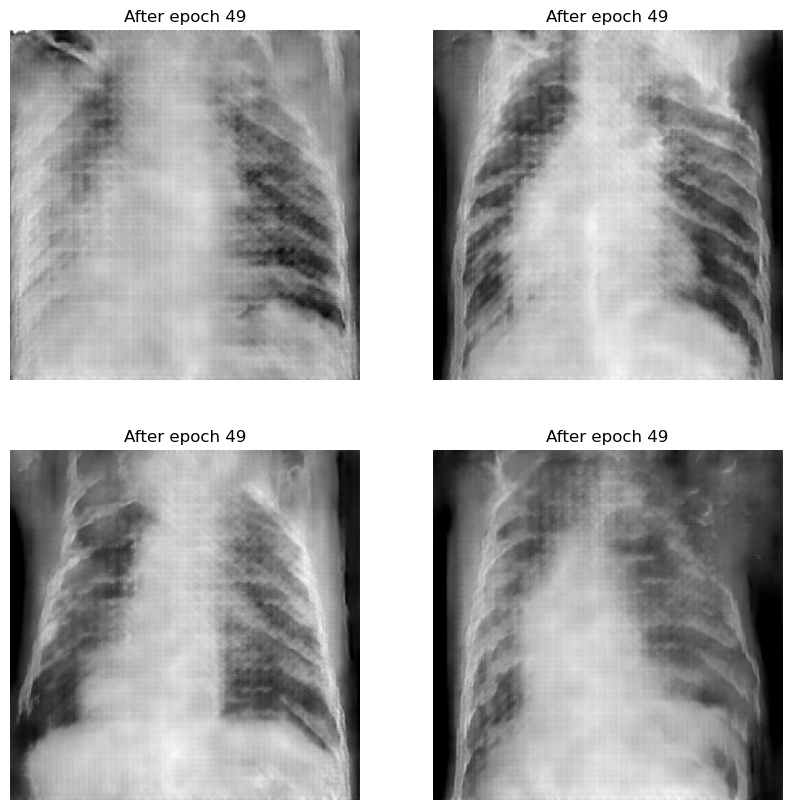

122/122 [==============================] - 389s 3s/step - disc_loss: 0.2137 - gen_loss: 3.5503
Epoch 50/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2000 - gen_loss: 3.5806

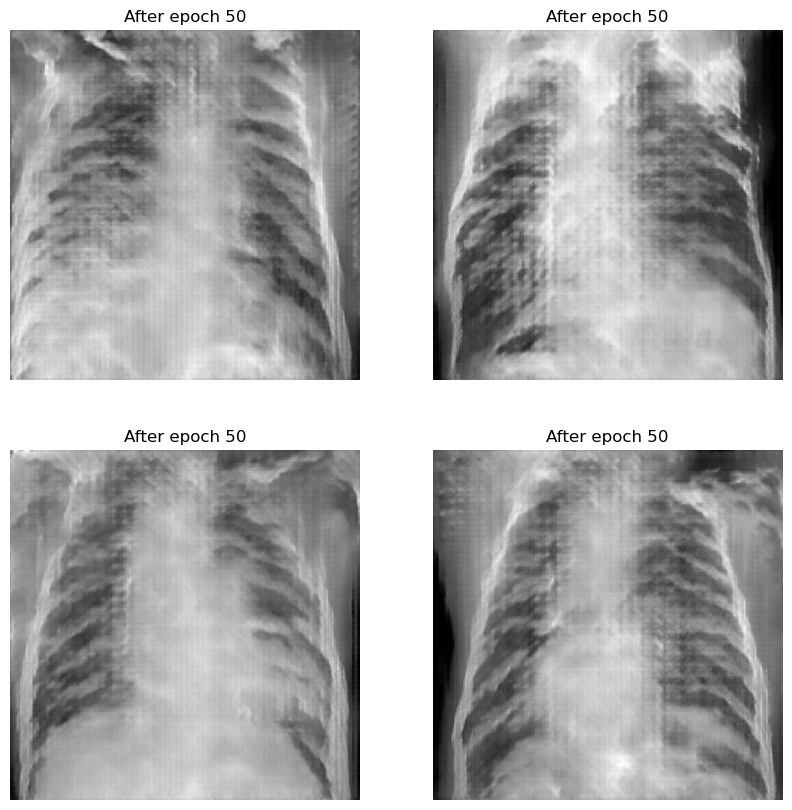

122/122 [==============================] - 391s 3s/step - disc_loss: 0.2000 - gen_loss: 3.5806
Epoch 51/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2132 - gen_loss: 3.6826

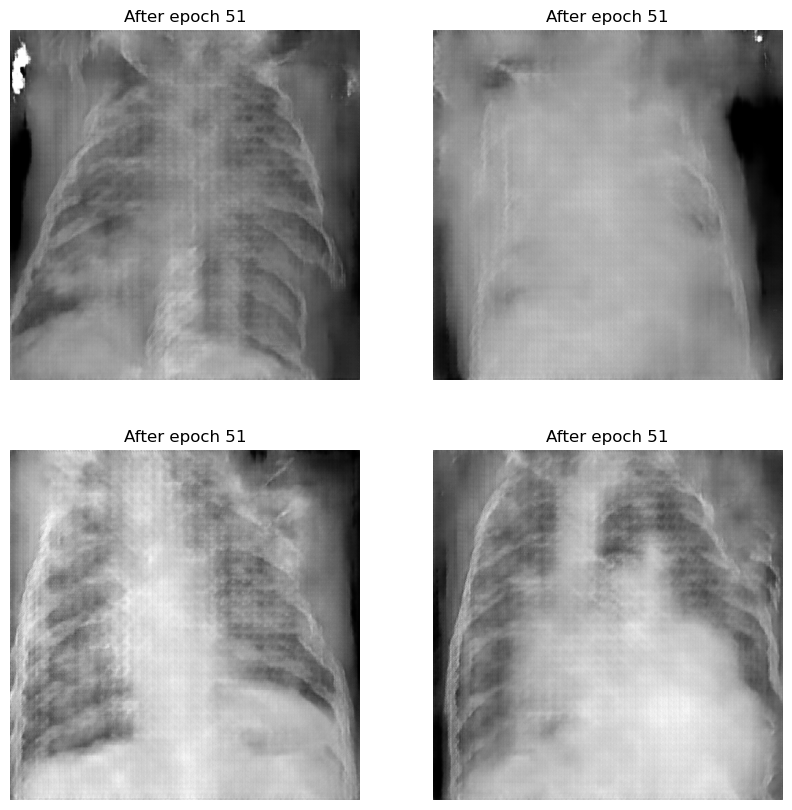

122/122 [==============================] - 391s 3s/step - disc_loss: 0.2132 - gen_loss: 3.6826
Epoch 52/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.1814 - gen_loss: 3.6911

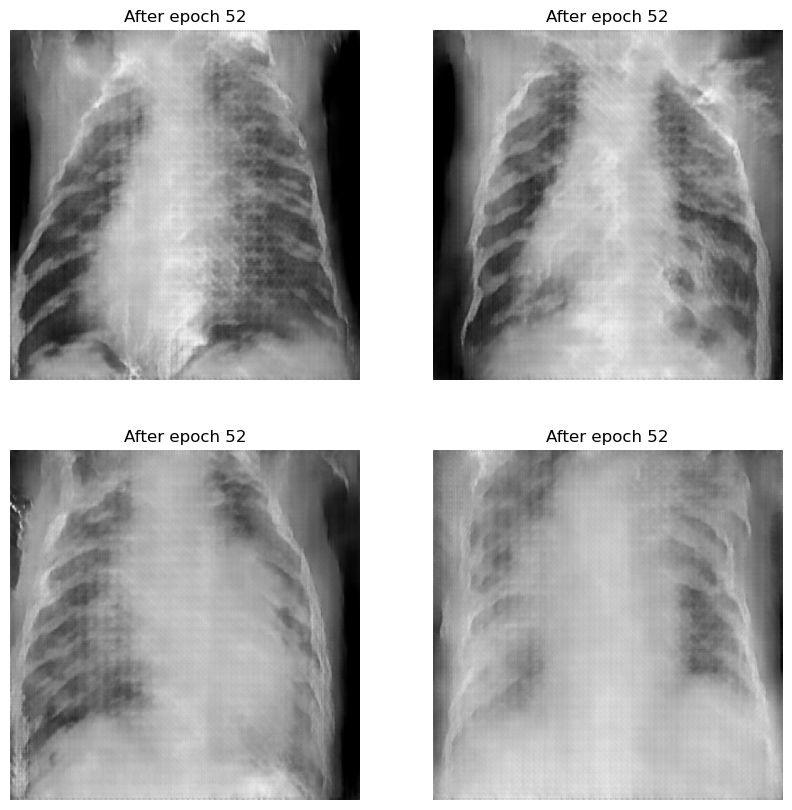

122/122 [==============================] - 393s 3s/step - disc_loss: 0.1814 - gen_loss: 3.6911
Epoch 53/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.1849 - gen_loss: 3.6661

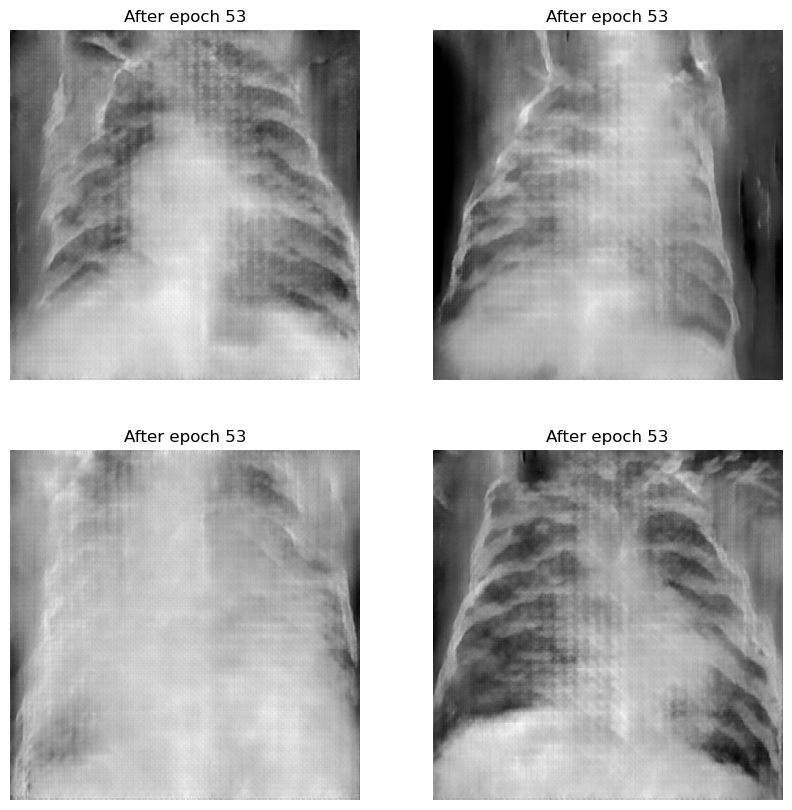

122/122 [==============================] - 389s 3s/step - disc_loss: 0.1849 - gen_loss: 3.6661
Epoch 54/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.1978 - gen_loss: 3.7612

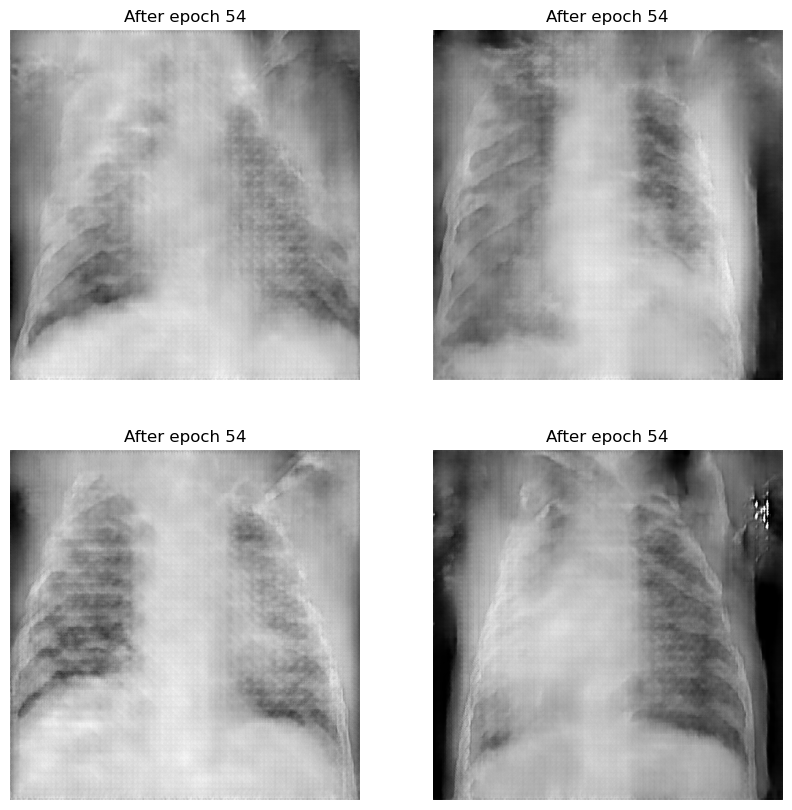

122/122 [==============================] - 388s 3s/step - disc_loss: 0.1978 - gen_loss: 3.7612
Epoch 55/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2032 - gen_loss: 3.8080

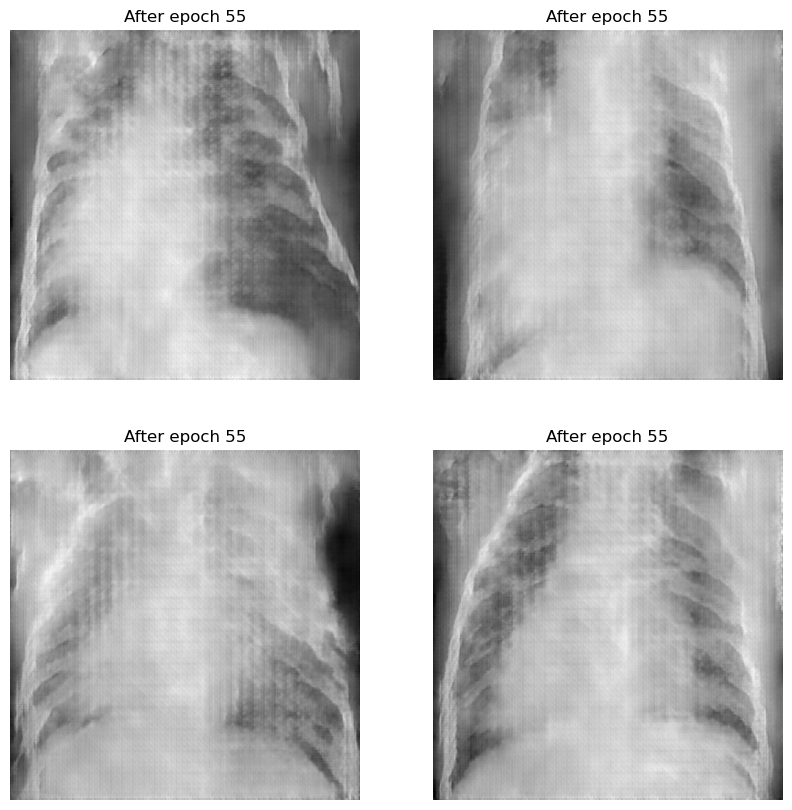

122/122 [==============================] - 393s 3s/step - disc_loss: 0.2032 - gen_loss: 3.8080
Epoch 56/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.1922 - gen_loss: 3.6137

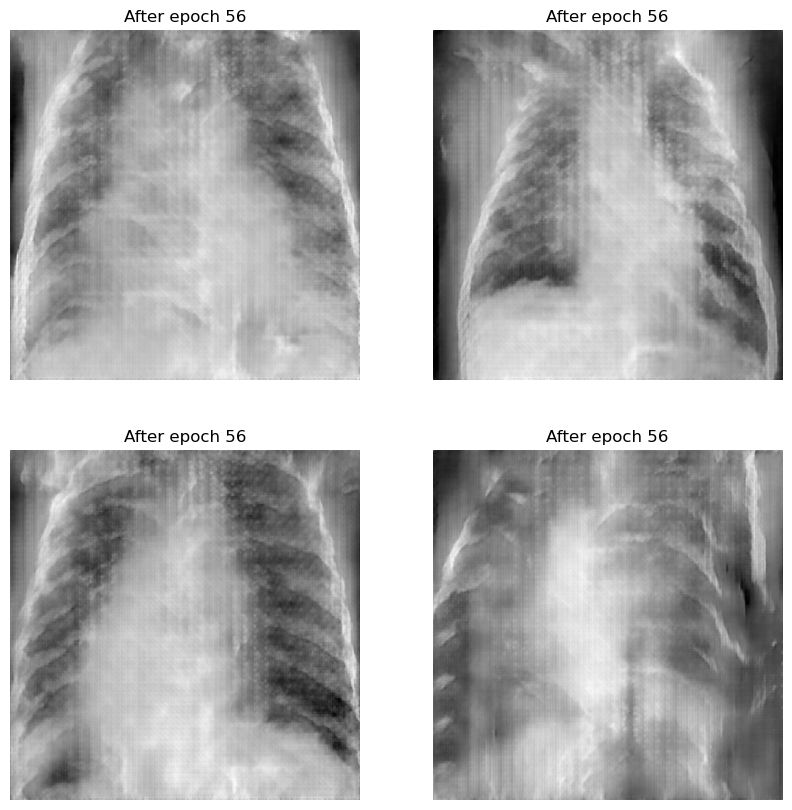

122/122 [==============================] - 389s 3s/step - disc_loss: 0.1922 - gen_loss: 3.6137
Epoch 57/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2018 - gen_loss: 3.6227

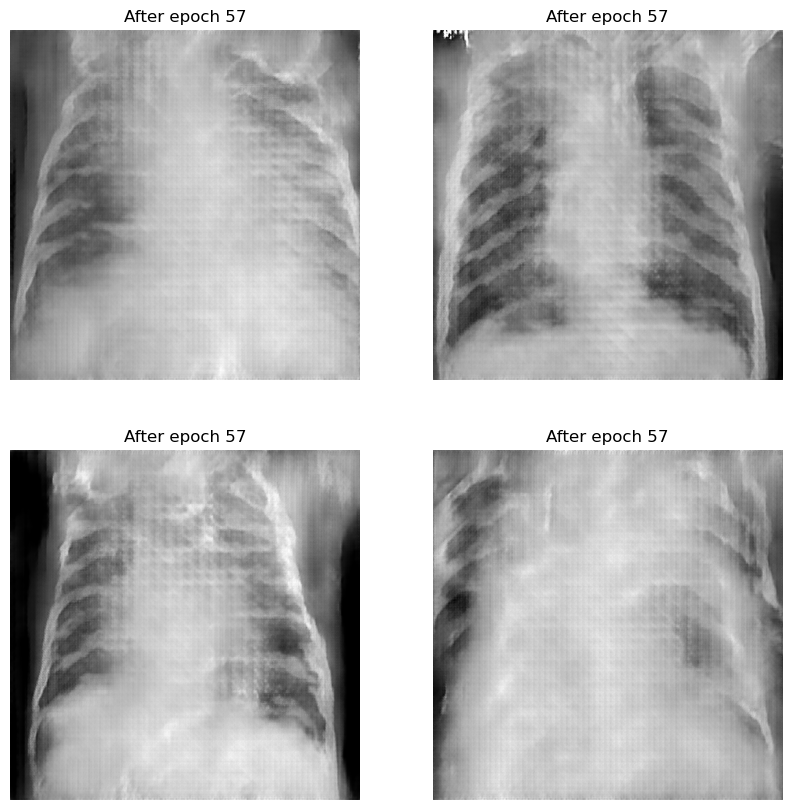

122/122 [==============================] - 387s 3s/step - disc_loss: 0.2018 - gen_loss: 3.6227
Epoch 58/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.1866 - gen_loss: 3.7986

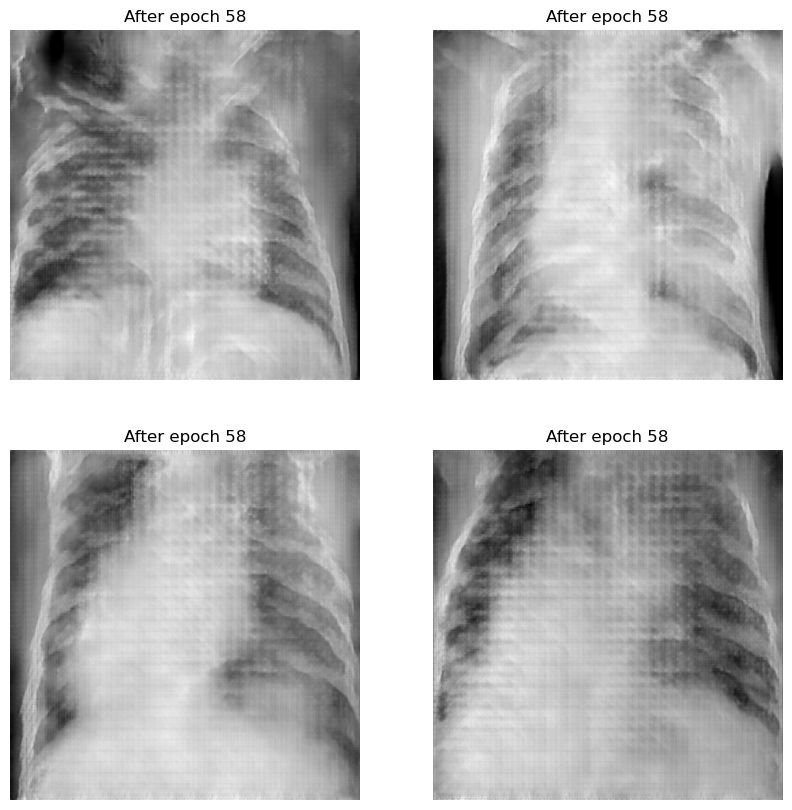

122/122 [==============================] - 386s 3s/step - disc_loss: 0.1866 - gen_loss: 3.7986
Epoch 59/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.1868 - gen_loss: 3.8384

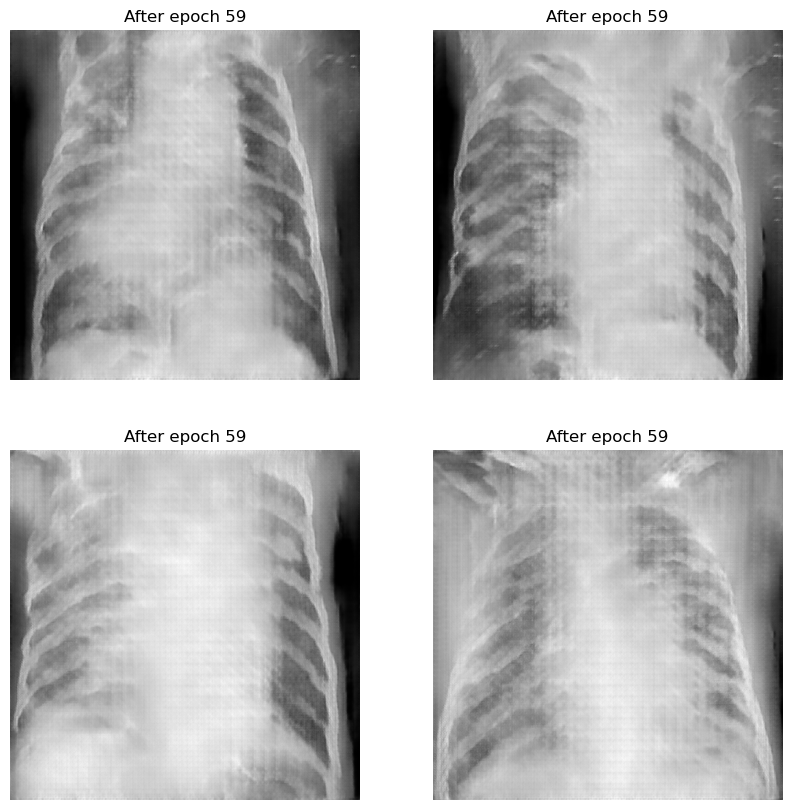

122/122 [==============================] - 387s 3s/step - disc_loss: 0.1868 - gen_loss: 3.8384
Epoch 60/1000
122/122 [==============================] - ETA: 0s - disc_loss: 0.2014 - gen_loss: 3.7566

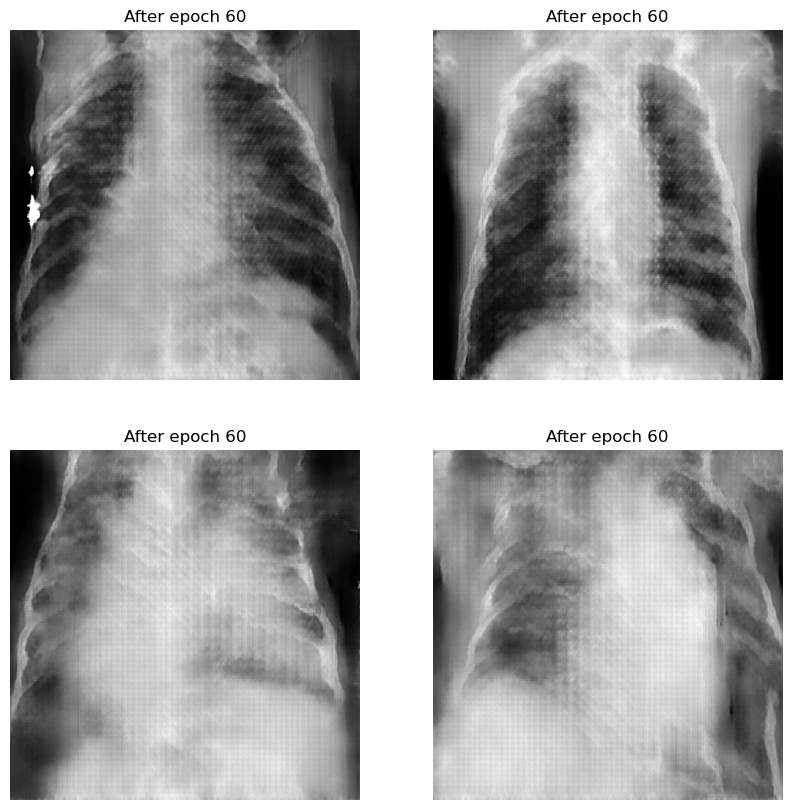

122/122 [==============================] - 390s 3s/step - disc_loss: 0.2014 - gen_loss: 3.7566
Epoch 61/1000
  5/122 [>.............................] - ETA: 6:34 - disc_loss: 0.2241 - gen_loss: 3.3525

KeyboardInterrupt: 

In [25]:
#actual traing begins here
gan.fit(
    image_loader(dataset), 
    epochs=EPOCHS,
    steps_per_epoch=len(dataset),  
    callbacks=[Gan_Callback(num_images=4, latent_dim=latent_dim)]
)
